<a href="https://colab.research.google.com/github/ish5ita/Text-Classification-and-Offensive-Speech-Detection-/blob/main/code.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Student ID: 2201110

**You student_id is your 7/8 digit faser number.**

This is a sample format for CE807: Assignment 2. You must follow the format.
The code will have three broad sections, and additional section, if needed,


1.   Common Codes
2.   Method/model 1 Specific Codes
3.   Method/model 2 Specific Codes
4.   Other Method/model Codes, if any

**You must have `train_method1`, `test_method1` for method 1 and `train_method2`, `test_method2` for method 2 to perform full training and testing. This will be evaluated automatically, without this your code will fail and no marked.**

You code should be proverly indended, print as much as possible, follow standard coding (https://peps.python.org/pep-0008/) and documentaion (https://colab.research.google.com/github/jakevdp/PythonDataScienceHandbook/blob/master/notebooks/01.01-Help-And-Documentation.ipynb) practices.

Before each `code cell`, you must have a `text cell` which explain what code cell is going to do. For each function/class, you need to properly document what are it's input, functionality and output.

If you are using any non-standard library, you must have command to install that, for example `pip install datasets`.

You must print `train`, `validation` and `test` performance measures.

You must also print `train` and `validation` loss in each `epoch`, wherever you are using `epoch`, say in any deep learning algorithms.

Your code must

*   To reproducibality of the results you must use a `seed`, you have to set seed in `torch`, `numpy` etc, use same seed everywhere **and your Student ID should be your seed**.
*   read dataset from './CE807/Assignment2/student_id/' folder which will have 3 files [`train.csv`, `val.csv`, `test.csv`]
*   save model after finishing the training in './CE807/Assignment2/student_id/models/XXX/' where XXX = [1,2] for both models
*   at testing time you will load models from './CE807/Assignment2/student_id/models/XXX/' where XXX = [1,2] and then test on your data, and save the output in the same folder
*   For Data Size Effect, you model and output save directories are './CE807/Assignment2/student_id/models/XXX/YYY/' where XXX = [1,2] and YYY = [25,50, 75,100]
*   **Your output file based on the test file will be named `output_test.csv` and will have fields `id`, `tweet`, `label` and `out_label`** Note that, `id`, `tweet`, `label` come from `test.csv`, and `out_label` out_label your model’s output, where out_label =[OFF,NOT]. You need to save file in the respective model folders.




**Install and import all required libraries first before starting to code.**








Let's install all require libraries. For example, `transformers`

In [ ]:
!pip install transformers

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


Let's import all require libraries.
For example, `numpy`

**Installing necessary Libraries**

In [ ]:
import numpy as np
import os
import pandas as pd
from sklearn.tree import DecisionTreeClassifier
from sklearn.feature_extraction.text import CountVectorizer
import re
import pickle
import matplotlib.pyplot as plt
import nltk
from nltk.util import pr
from matplotlib import style
from tensorflow.keras.callbacks import EarlyStopping
style.use('ggplot')
stemmer=nltk.SnowballStemmer("english")
from sklearn.metrics import confusion_matrix, f1_score, accuracy_score,precision_score, recall_score
import matplotlib.pyplot as plt
import os
import re
import shutil
import string
import tensorflow as tf
from tensorflow.keras import regularizers
from tensorflow.keras import layers
from tensorflow.keras import losses
from sklearn.model_selection import GridSearchCV
import warnings
warnings.filterwarnings('ignore')
import seaborn as sns
from collections import Counter
import pandas as pd
import numpy as np
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, ConfusionMatrixDisplay
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from tensorflow.keras import preprocessing
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
import os
from google.colab import drive
from keras.preprocessing import text
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import SGDClassifier
from sklearn.feature_extraction.text import CountVectorizer,TfidfTransformer
from keras.preprocessing import sequence
from keras.preprocessing import text
from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation
from keras.layers import Embedding, LSTM
from keras.layers import Conv1D, Flatten,GlobalMaxPooling1D
nltk.download('punkt')
from nltk.stem import WordNetLemmatizer
from nltk.stem import SnowballStemmer
from nltk.corpus import stopwords
import matplotlib.pyplot as plt
nltk.download('stopwords')



[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

**Let's put your student id as a variable, that you will use different places**

In [ ]:
student_id = 2201110 # Note this is an interger and you need to input your id

Let's set `seed` for all libraries like `torch`, `numpy` etc as my student id

In [ ]:
# set same seeds for all libraries

#numpy seed
np.random.seed(student_id)

# Common Codes

In this section you will write all common codes, for examples


*   Data read
*   Data Splitting
*   Performance Matrics
*   Print Dataset Statistics
*   Saving model and output
*   Loading Model and output
*   etc




**Let's first allow the GDrive access and set data and model paths**

For examples,

student_id = 1234567

set GOOGLE_DRIVE_PATH_AFTER_MYDRIVE = ‘./CE807/Assignment2/student_id/’ in your GDrive

now set all global variable,
(Example for model 1 with 25% of data)

train_file = os.path.join(GOOGLE_DRIVE_PATH_AFTER_MYDRIVE, 'train.csv')

MODEL_1_DIRECTORY = os.path.join('gdrive', 'MyDrive', GOOGLE_DRIVE_PATH, ‘models’, ‘1’)

MODEL_1_25_DIRECTORY = os.path.join('MODEL_1_DIRECTORY',‘25’)

model_1_25_output_test_file = os.path.join(MODEL_1_25_DIRECTORY,'output_test.csv')

Sample output directory and file structure: https://drive.google.com/drive/folders/1okgSzgGiwPYYFp7NScEt9MNVolOlld1d?usp=share_link   

In [ ]:
# Mount Google Drive
from google.colab import drive
drive.mount('/content/gdrive', force_remount=True)

Mounted at /content/gdrive


In [ ]:
# Add your code to initialize GDrive and data and models paths
# TODO: Fill in the Google Drive path where you uploaded the assignment, data and code
# Example: If your student_id is 1234567 then your directory will be './CE807/Assignment2/1234567/'

GOOGLE_DRIVE_PATH_AFTER_MYDRIVE = os.path.join('./CE807/Assignment2/',str(student_id)) # Make sure to update with your student_id and student_id is an integer
GOOGLE_DRIVE_PATH = os.path.join('gdrive', 'MyDrive', GOOGLE_DRIVE_PATH_AFTER_MYDRIVE)
print('List files: ', os.listdir(GOOGLE_DRIVE_PATH))
#Loading all the training files
train_file = os.path.join(GOOGLE_DRIVE_PATH, 'train.csv')
print('Train file: ', train_file)
#Loading all the validation files
val_file = os.path.join(GOOGLE_DRIVE_PATH, 'valid.csv')
print('Validation file: ', val_file)
#Loading all the testing files
test_file = os.path.join(GOOGLE_DRIVE_PATH, 'test.csv')
print('Test file: ', test_file)

List files:  ['valid.csv', 'code.ipynb', 'train.csv', 'test.csv', 'models', 'train_25.csv', 'train_50.csv', 'train_75.csv', 'train_100.csv']
Train file:  gdrive/MyDrive/./CE807/Assignment2/2201110/train.csv
Validation file:  gdrive/MyDrive/./CE807/Assignment2/2201110/valid.csv
Test file:  gdrive/MyDrive/./CE807/Assignment2/2201110/test.csv


In [ ]:
#Classes proportion in dependent variable in train,validation and test dataset
train_df = pd.read_csv(train_file)
print('===========Train Data =========')
print(train_df['label'].value_counts())
print("TOTAL",len(train_df))
print('==============================')
val_df = pd.read_csv(val_file)
print('===========Validation Data =========')
print(val_df['label'].value_counts())
print("TOTAL",len(val_df))
print('==============================')
test_data=pd.read_csv(test_file)
print('===========Test Data =========')
print(test_data['label'].value_counts())
print("TOTAL",len(test_data))
print('==============================')

===========Train Data =========
NOT    8221
OFF    4092
Name: label, dtype: int64
TOTAL 12313
===========Validation Data =========
NOT    619
OFF    308
Name: label, dtype: int64
TOTAL 927
===========Test Data =========
NOT    620
OFF    240
Name: label, dtype: int64
TOTAL 860


# **Visualization to understand the label distribution**

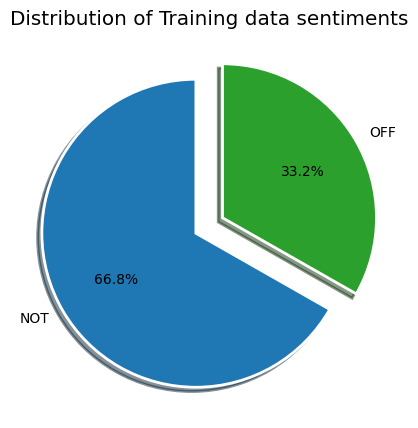

In [ ]:
  fig = plt.figure(figsize=(5,5))
  # Define custom colors
  colors = ["tab:blue", "tab:green"]
  # Define wedge properties
  wp = {'linewidth':2, 'edgecolor':"white"}
  # Count the number of occurrences for each label
  tags = train_df['label'].value_counts()
  # Define the explode parameter for the pie chart
  explode = (0.1, 0.1)
  # Create a pie chart with the specified parameters
  tags.plot(kind='pie',autopct='%1.1f%%', shadow=True, colors=colors, startangle=90,
          wedgeprops=wp, explode=explode, label='')
  plt.title('Distribution of Training data sentiments')
  plt.show()


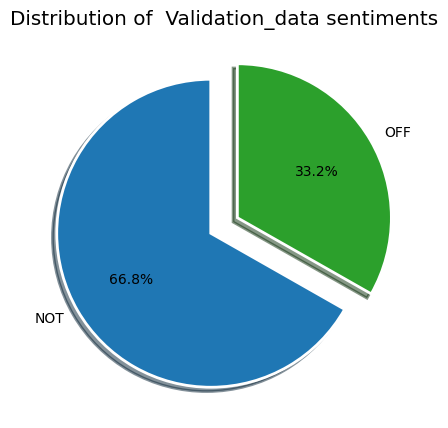

In [ ]:
  fig = plt.figure(figsize=(5,5))
  # Define custom colors
  colors = ["tab:blue", "tab:green"]
  # Define wedge properties
  wp = {'linewidth':2, 'edgecolor':"white"}
  # Count the number of occurrences for each label
  tags = val_df['label'].value_counts()
  # Define the explode parameter for the pie chart
  explode = (0.1, 0.1)
  # Create a pie chart with the specified parameters
  tags.plot(kind='pie',autopct='%1.1f%%', shadow=True, colors=colors, startangle=90,
          wedgeprops=wp, explode=explode, label='')
  plt.title('Distribution of  Validation_data sentiments')
  plt.show()


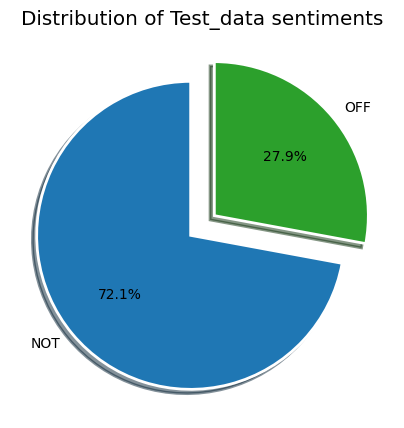

In [ ]:
  fig = plt.figure(figsize=(5,5))
  # Define custom colors
  colors = ["tab:blue", "tab:green"]
  # Define wedge properties
  wp = {'linewidth':2, 'edgecolor':"white"}
  # Count the number of occurrences for each label
  tags = test_data['label'].value_counts()
  # Define the explode parameter for the pie chart
  explode = (0.1, 0.1)
  # Create a pie chart with the specified parameters
  tags.plot(kind='pie',autopct='%1.1f%%', shadow=True, colors=colors, startangle=90,
          wedgeprops=wp, explode=explode, label='')
  plt.title('Distribution of Test_data sentiments')
  plt.show()


# **Splitting the data**

In [ ]:
data = pd.read_csv('/content/gdrive/MyDrive/CE807/Assignment2/2201110/train.csv')
print(f"Total number : {len(data)}")

# Shuffle the data
data = data.sample(frac=1, random_state=42).reset_index(drop=True)
train_25 = data.iloc[:int(0.25*len(data)), :]
train_50 = data.iloc[:int(0.5*len(data)), :]
train_75 = data.iloc[:int(0.75*len(data)), :]
train_100 = data.copy()


print(f"Number of instances in train_25: {len(train_25)}")
print(f"Number of instances in train_50: {len(train_50)}")
print(f"Number of instances in train_75: {len(train_75)}")
print(f"Number of instances in train_100: {len(train_100)}")

# Save the data to the specified directory
train_25.to_csv(f'/content/gdrive/MyDrive/CE807/Assignment2/2201110/train_25.csv', index=False)
train_50.to_csv(f'/content/gdrive/MyDrive/CE807/Assignment2/2201110/train_50.csv', index=False)
train_75.to_csv(f'/content/gdrive/MyDrive/CE807/Assignment2/2201110/train_75.csv', index=False)
train_100.to_csv(f'/content/gdrive/MyDrive/CE807/Assignment2/2201110/train_100.csv', index=False)



train_50_file = os.path.join(GOOGLE_DRIVE_PATH, 'train_50.csv')
train_75_file = os.path.join(GOOGLE_DRIVE_PATH, 'train_75.csv')
train_25_file = os.path.join(GOOGLE_DRIVE_PATH, 'train_25.csv')
train_file = os.path.join(GOOGLE_DRIVE_PATH, 'train_100.csv')
train_100=train_file

Total number : 12313
Number of instances in train_25: 3078
Number of instances in train_50: 6156
Number of instances in train_75: 9234
Number of instances in train_100: 12313


# **Creating directory for different models and data distribution**

In [ ]:

MODEL_1_DIRECTORY = os.path.join(GOOGLE_DRIVE_PATH, 'models', '1') # Model 1 directory
print('Model 1 directory: ', MODEL_1_DIRECTORY)

MODEL_2_DIRECTORY = os.path.join(GOOGLE_DRIVE_PATH, 'models', '2') # Model 2 directory
print('Model 2 directory: ', MODEL_2_DIRECTORY)

MODEL_1_25_DIRECTORY = os.path.join(MODEL_1_DIRECTORY,'25') # Model 1 trained using 25% of train data directory
print('Model 1 directory with 25% data: ', MODEL_1_25_DIRECTORY)

model_1_25_output_test_file = os.path.join(MODEL_1_25_DIRECTORY, 'output_test.csv') # Output file using Model 1 trained using 25% of train data
print('Output file name using model 1 using 25% of train data: ',model_1_25_output_test_file)

MODEL_1_50_DIRECTORY = os.path.join(MODEL_1_DIRECTORY,'50') # Model 1 trained using 50% of train data directory
print('Model 1 directory with 50% data: ', MODEL_1_50_DIRECTORY)

model_1_50_output_test_file = os.path.join(MODEL_1_50_DIRECTORY, 'output_test.csv') # Output file using Model 1 trained using 50% of train data
print('Output file name using model 1 using 50% of train data: ',model_1_50_output_test_file)


MODEL_1_75_DIRECTORY = os.path.join(MODEL_1_DIRECTORY,'75') # Model 1 trained using 75% of train data directory
print('Model 1 directory with 75% data: ', MODEL_1_75_DIRECTORY)

model_1_75_output_test_file = os.path.join(MODEL_1_75_DIRECTORY, 'output_test.csv') # Output file using Model 1 trained using 75% of train data
print('Output file name using model 1 using 75% of train data: ',model_1_75_output_test_file)


MODEL_1_100_DIRECTORY = os.path.join(MODEL_1_DIRECTORY,'100') # Model 1 trained using 100% of train data directory
print('Model 1 directory with 100% data: ', MODEL_1_100_DIRECTORY)

model_1_100_output_test_file = os.path.join(MODEL_1_100_DIRECTORY, 'output_test.csv') # Output file using Model 1 trained using 100% of train data
print('Output file name using model 1 using 100% of train data: ',model_1_100_output_test_file)

Model 1 directory:  gdrive/MyDrive/./CE807/Assignment2/2201110/models/1
Model 2 directory:  gdrive/MyDrive/./CE807/Assignment2/2201110/models/2
Model 1 directory with 25% data:  gdrive/MyDrive/./CE807/Assignment2/2201110/models/1/25
Output file name using model 1 using 25% of train data:  gdrive/MyDrive/./CE807/Assignment2/2201110/models/1/25/output_test.csv
Model 1 directory with 50% data:  gdrive/MyDrive/./CE807/Assignment2/2201110/models/1/50
Output file name using model 1 using 50% of train data:  gdrive/MyDrive/./CE807/Assignment2/2201110/models/1/50/output_test.csv
Model 1 directory with 75% data:  gdrive/MyDrive/./CE807/Assignment2/2201110/models/1/75
Output file name using model 1 using 75% of train data:  gdrive/MyDrive/./CE807/Assignment2/2201110/models/1/75/output_test.csv
Model 1 directory with 100% data:  gdrive/MyDrive/./CE807/Assignment2/2201110/models/1/100
Output file name using model 1 using 100% of train data:  gdrive/MyDrive/./CE807/Assignment2/2201110/models/1/100/

Let's see train file

Let's show you a sample output file. Notice all fields, `out_label` is your model's output for that `tweet` and `id`

We are going to use different performance matrics like Accuracy, Recall (macro), Precision (macro), F1 (macro) and Confusion Matrix for the performance evaluation. We will print all the matrics and display Confusion Matrix with proper X & Y axis labels

## **Computing performance**

In [ ]:
def compute_performance(y_true, y_pred,split='test'):
  """
    prints different performance matrics like  Accuracy, Recall (macro), Precision (macro), and F1 (macro).
    This also display Confusion Matrix with proper X & Y axis labels.
    Also, returns F1 score
    Args:
        y_true: numpy array or list
        y_pred: numpy array or list
    Returns:
        float
    """
    ##########################################################################
    #                     TODO: Implement this function                      #
    ##########################################################################
  #Calculating Accuracy
  acc = accuracy_score(y_true, y_pred)
  #Calculating Recall
  recall = recall_score(y_true, y_pred, average="macro")
  #Calculating Precision
  precision = precision_score(y_true, y_pred, average="macro")
  # Calculate F1 score
  f1score=f1_score(y_true, y_pred, average='macro')
  print("Accuracy: {:.2f}".format(acc))
  print("F1 score: {:.2f}".format(f1score))
  print("Recall: {:.4f}".format(recall))
  print("Precision: {:.4f}".format(precision))
 #Multipying eith 100 to get percentage
  valid_accuracy=acc*100
  #Calculate confusion matrix
  confmat= confusion_matrix(y_true, y_pred)
  print(confmat)
  # Plot confusion matrix using heatmap
  sns.heatmap(confmat, annot=True, fmt='d', cmap='Reds')
  plt.show()
  from sklearn.metrics import classification_report
  print(classification_report(y_true, y_pred))
  return f1score,valid_accuracy

    ##########################################################################
    #                            END OF YOUR CODE                            #
    ##########################################################################


# Method 1 Start

In this section you will write all details of your Method 1.

You will have to enter multiple `code` and `text` cell.

Your code should follow the standard ML pipeline


*   Data reading
*   Data clearning, if any
*   Convert data to vector/tokenization/vectorization
*   Model Declaration/Initialization/building
*   Training and validation of the model using training and validation dataset
*   Save the trained model
*   Load and Test the model on testing set
*   Save the output of the model


You could add any other step(s) based on your method's requirement.

After finishing the above, you need to usd splited data as defined in the assignment and then do the same for all 4 sets. Your code should not be copy-pasted 4 time, make use of `function`.


# **Pre-Processing the datasets**

In [ ]:
def prepare_dataset1(train_df, count_vectorizer=None, split='test'):
  #To view how many are offensive tweets
  fig = plt.figure(figsize=(5,5))
  sns.countplot(x='label', data = train_df)
  #Reducing the dimensionality of the dataset
  train_df=train_df.drop('id',axis=1)
  #Lowercasing: Changing all the letters to be lowercase.
  train_df['tweet'] = train_df['tweet'].str.lower()
  print("AFTER LOWERCASING :",train_df.head())
  print("___________________________________________________________")
  #Noise removal: Removing special characters (such as punctuations).
  train_df['tweet'] = train_df['tweet'].apply(lambda y: re.sub(r'@user\w*\b', '', y))
  train_df['tweet'] = train_df['tweet'].apply(lambda x: re.sub(r'[^\w\s#@€™]', '', x))
  train_df['tweet'] = train_df['tweet'].apply(lambda x: re.sub(r'\buser\b', '', x))

  print("AFTER NOISE REMOVAL :",train_df.head() )
  print("___________________________________________________________")

  #LEMMATIZATION:Lemmatization is the process of reducing a word to its base or root form
  # Initialize lemmatizer
  # Downloading WordNet corpus for lemmatization
  nltk.download('wordnet')
  # Initialize stemmer for English
  stemmer = SnowballStemmer('english')
  # Apply stemming function to DataFrame
  def stem_string(tweet):
    words = nltk.word_tokenize(tweet)
    stemmed_words = [stemmer.stem(word) for word in words]
    return ' '.join(stemmed_words)
    train_df['tweet'] = train_df['tweet'].apply(stem_string)
  print("AFTER LEMMATIZATION :",train_df.head() )
  print("___________________________________________________________")

  #STOPWORD REMOVAL:Stop words removal: Removing commonly used words.
  def remove_stop_words(tweet):
    stop_words = set(nltk.corpus.stopwords.words('english'))
    filtered_text = []
    for word in tweet.split():
        if word.lower() not in stop_words:
            filtered_text.append(word)
    return " ".join(filtered_text)
  train_df['tweet'] = train_df['tweet'].apply(remove_stop_words)
  print("AFTER STOPWORD REMOVAL :",train_df.head() )
  print("___________________________________________________________")
  #Prepare Wordcloud with most frequent words in offensive tweets
  non_hate_tweets = train_df[train_df.label == "OFF"]
  text = ' '.join([word for word in non_hate_tweets['tweet']])
  plt.figure(figsize=(14,8), facecolor='None')
  from wordcloud import WordCloud
  wordcloud = WordCloud(max_words=500, width=850, height=400).generate(text)
  plt.imshow(wordcloud, interpolation='bilinear')
  plt.axis('off')
  plt.title('Most frequent words in Offensive tweets', fontsize = 15)
  plt.show()
  #Prepare Wordcloud with most frequent words in non offensive tweets
  non_hate_tweets = train_df[train_df.label == "NOT"]
  text = ' '.join([word for word in non_hate_tweets['tweet']])
  plt.figure(figsize=(14,8), facecolor='None')
  from wordcloud import WordCloud
  wordcloud = WordCloud(max_words=500, width=700, height=400).generate(text)
  plt.imshow(wordcloud, interpolation='bilinear')
  plt.axis('off')
  plt.title('Most frequent words in non hate tweets', fontsize = 15)
  plt.show()
  # Applying Count Vectorizer
  if split == 'train':
      count_vectorizer = CountVectorizer(stop_words='english',max_features=5000)
      values = count_vectorizer.fit_transform(train_df['tweet'].values)
  else:
      values = count_vectorizer.transform(train_df['tweet'].values)
  if split == 'train':
      return values, count_vectorizer
  else:
      return values

# **MODEL 1-Logistic Regression**

In [ ]:
def train_model1(text_vector,label):

    print('Let\'s start training using LogisticRegression')
    # Define parameter grid for
    param_grid = {'C':[100, 10, 1.0, 0.1, 0.01], 'solver' :['newton-cg', 'lbfgs','liblinear']}
    grid = GridSearchCV(LogisticRegression(), param_grid, cv = 5)
    grid.fit(text_vector, label)
    print("Best Cross validation score: {:.2f}".format(grid.best_score_))
    print("Best parameters: ", grid.best_params_)
    return grid


### **Training Method 1 Code**
Your test code should be a stand alone code that must take `train_file`, `val_file`,  and `model_dir` as input. You could have other things as also input, but these three are must. You would load both files, and train using the `train_file` and validating using the `val_file`. You will `print` / `display`/ `plot` all performance metrics, loss(if available) and save the output model in the `model_dir`.

Note that at the testing time, you need to use the same pre-processing and model. So, it would be good that you make those as seperate function/pipeline whichever it the best suited for your method. Don't copy-paste same code twice, make it a fucntion/class whichever is best.

In [ ]:
def train_method1(train_file,val_file, model_dir):
    ##########################################################################
    #                     TODO: Implement this function                      #
    ##########################################################################

  train_df = pd.read_csv(train_file)
  val_df = pd.read_csv(val_file)
  print('Train data len:'+str(len(train_df)))
  print('Valid data len:'+str(len(val_df)))
  #DROPPING DUPLICATES
  train_df=train_df.drop_duplicates()
  train_label = train_df['label']
  val_label = val_df['label']
  #Preprocessing the dataset-Training and validation
  train_values, count_vectorizer = prepare_dataset1(train_df, split='train')
  val_values= prepare_dataset1(val_df,count_vectorizer)
  #Training the model with Model1
  model = train_model1(train_values,train_label)
  model_file, vectorizer_file = save_model1(model, count_vectorizer, model_dir)
  val_pred_label = model.predict(val_values)
  f1score,valid_accuracy= compute_performance(val_label, val_pred_label)
  fig = plt.figure(figsize=(5,5))
  # Define custom colors
  colors = ["tab:blue", "tab:green"]
  # Define wedge properties
  wp = {'linewidth':2, 'edgecolor':"white"}
  # Count the number of occurrences for each label
  tags = train_df['label'].value_counts()
  # Define the explode parameter for the pie chart
  explode = (0.1, 0.1)
  # Create a pie chart with the specified parameters
  tags.plot(kind='pie',autopct='%1.1f%%', shadow=True, colors=colors, startangle=90,
          wedgeprops=wp, explode=explode, label='')
  plt.title('Distribution of Training_data sentiments')
  plt.show()

  return model_file, vectorizer_file,f1score,valid_accuracy


    ##########################################################################
    #                            END OF YOUR CODE                            #
    ##########################################################################



**LETS TRAIN USING 25%**

Train using of 25% of data
Train data len:3078
Valid data len:927
AFTER LOWERCASING :                                                tweet label
0  @user that was awesome. i love hearing you des...   OFF
1               @user conspiracy theories abound....   NOT
2  #toxictory minister @user attempted to expense...   NOT
3  @user lol religion of peace" am i right fellow...   NOT
4                           @user google go to hell!   OFF
___________________________________________________________
AFTER NOISE REMOVAL :                                                tweet label
0   that was awesome i love hearing you destroy t...   OFF
1                         conspiracy theories abound   NOT
2  #toxictory minister  attempted to expense 50 c...   NOT
3   lol religion of peace am i right fellow class...   NOT
4                                  google go to hell   OFF
___________________________________________________________
AFTER LEMMATIZATION :                                           

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


AFTER STOPWORD REMOVAL :                                                tweet label
0      awesome love hearing destroy liberals trudeau   OFF
1                         conspiracy theories abound   NOT
2  #toxictory minister attempted expense 50 chari...   NOT
3  lol religion peace right fellow classical libe...   NOT
4                                     google go hell   OFF
___________________________________________________________


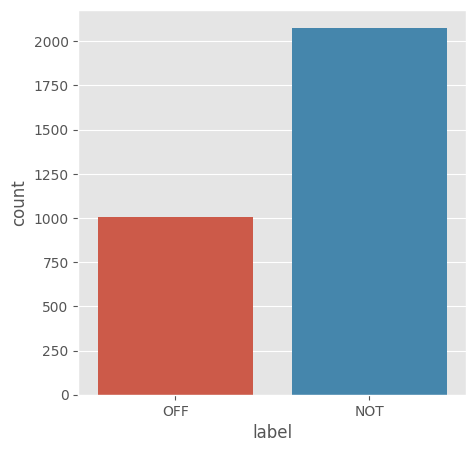

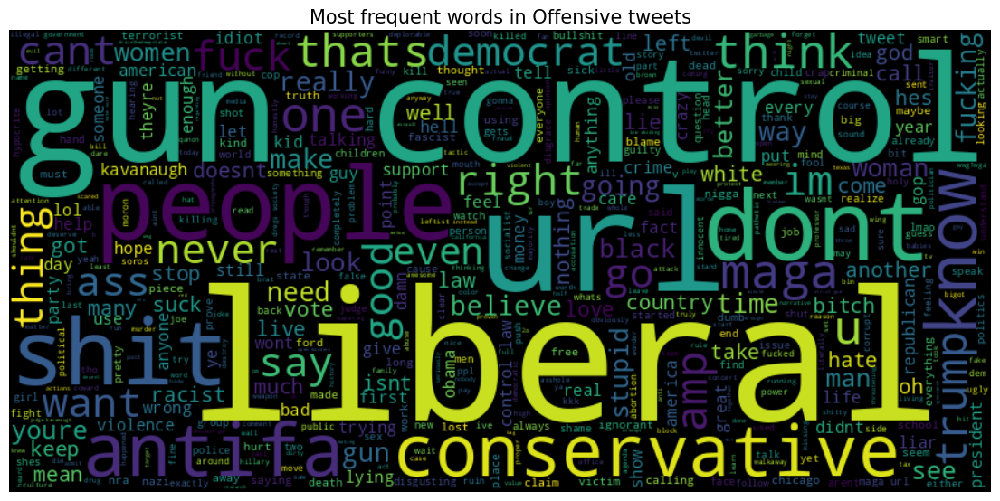

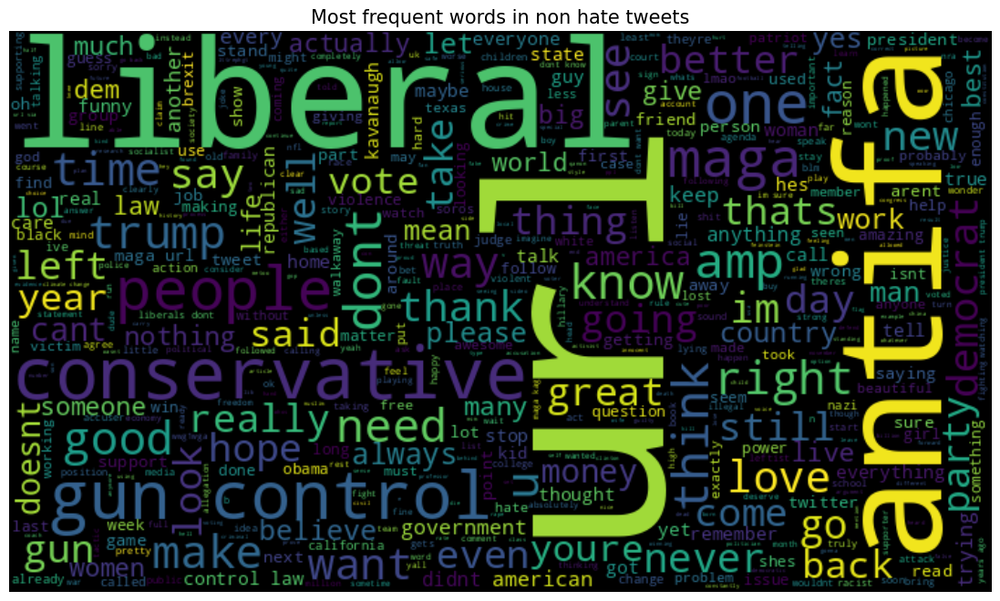

AFTER LOWERCASING :                                                tweet label
0  @user @user @user trump is declassifying infor...   NOT
1  @user ha even with them trying to rig the syst...   NOT
2  @user @user @user man you really thought this ...   NOT
3  @user ms. clinton - you are a class act. my re...   OFF
4  @user it’s still here at 753. if someone did t...   NOT
___________________________________________________________
AFTER NOISE REMOVAL :                                                tweet label
0     trump is declassifying information and ther...   NOT
1   ha even with them trying to rig the system th...   NOT
2         man you really thought this was it huh url   NOT
3   ms clinton  you are a class act my response t...   OFF
4   its still here at 753 if someone did this to ...   NOT
___________________________________________________________
AFTER LEMMATIZATION :                                                tweet label
0     trump is declassifying information and ther

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


AFTER STOPWORD REMOVAL :                                                tweet label
0  trump declassifying information nothing subjec...   NOT
1  ha even trying rig system idea divine interven...   NOT
2                         man really thought huh url   NOT
3  ms clinton class act response idiot would like...   OFF
4    still 753 someone family shed enraged let loose   NOT
___________________________________________________________


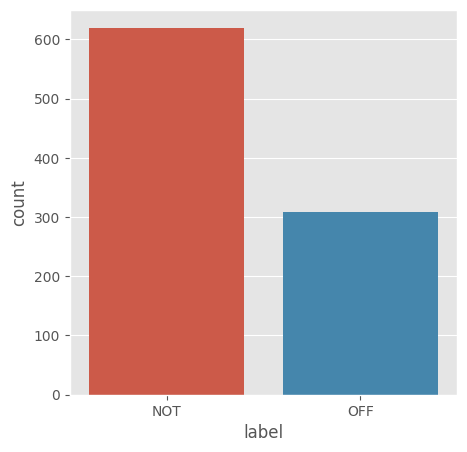

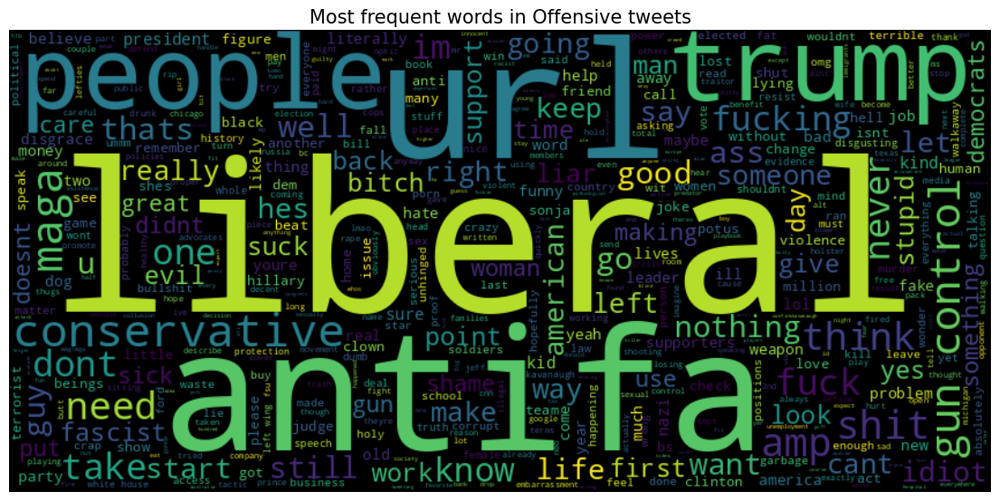

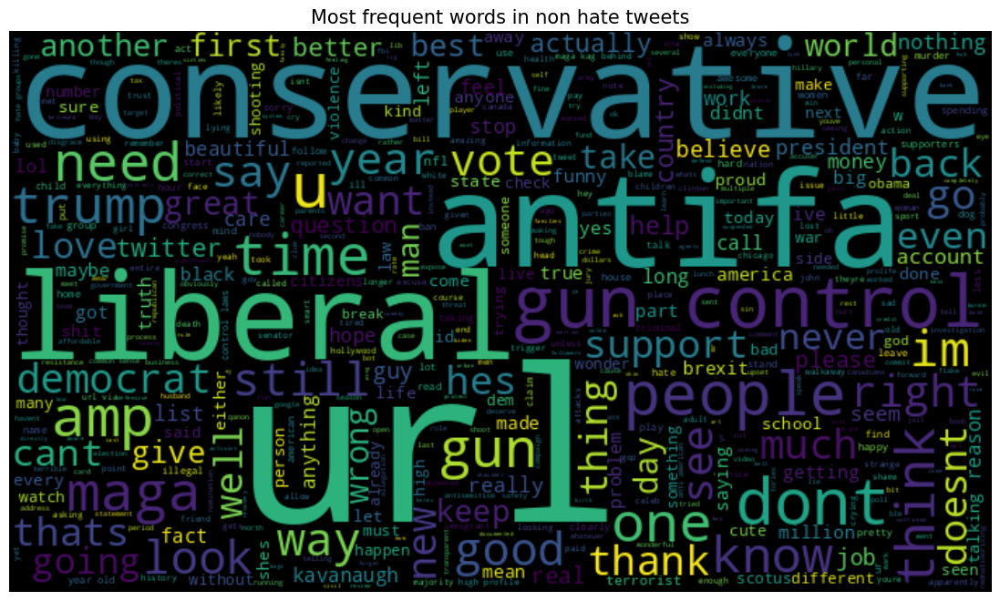

Let's start training using LogisticRegression
Best Cross validation score: 0.73
Best parameters:  {'C': 1.0, 'solver': 'newton-cg'}
Saved model to  gdrive/MyDrive/./CE807/Assignment2/2201110/models/1/25/model.sav
Saved Vectorizer to  gdrive/MyDrive/./CE807/Assignment2/2201110/models/1/25/vectorizer.sav
Accuracy: 0.74
F1 score: 0.67
Recall: 0.6585
Precision: 0.7142
[[556  63]
 [179 129]]


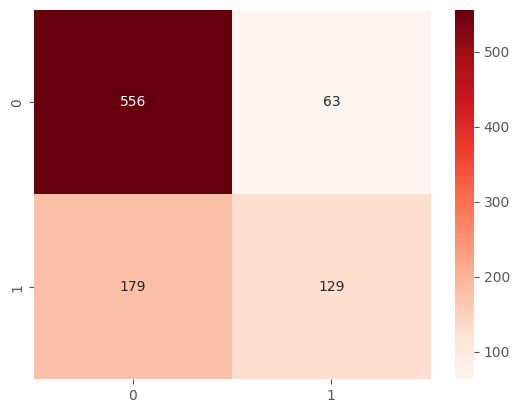

              precision    recall  f1-score   support

         NOT       0.76      0.90      0.82       619
         OFF       0.67      0.42      0.52       308

    accuracy                           0.74       927
   macro avg       0.71      0.66      0.67       927
weighted avg       0.73      0.74      0.72       927



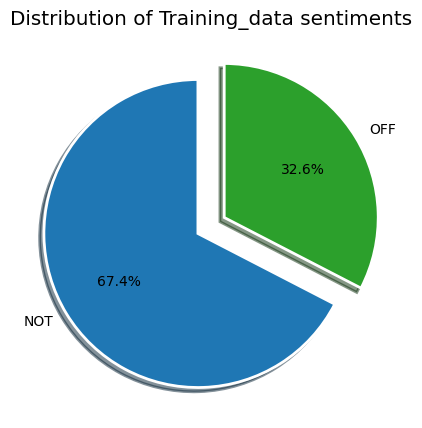

[0.6686351550960119]


In [ ]:
#Using list to store f1_Score and accuracy value to use it later for the plot
f1scorelist=[]
valid_accuracy_list=[]
print('Train using of 25% of data')
model_25_file, vectorizer_25_file,f1score,valid_accuracy = train_method1(train_25_file, val_file, MODEL_1_25_DIRECTORY)
valid_accuracy_list.append(valid_accuracy)
f1scorelist.append(f1score)
print(f1scorelist)


**LETS TRAIN USING 50%**

Train using of 50% of data
Train data len:6156
Valid data len:927
AFTER LOWERCASING :                                                tweet label
0  @user that was awesome. i love hearing you des...   OFF
1               @user conspiracy theories abound....   NOT
2  #toxictory minister @user attempted to expense...   NOT
3  @user lol religion of peace" am i right fellow...   NOT
4                           @user google go to hell!   OFF
___________________________________________________________
AFTER NOISE REMOVAL :                                                tweet label
0   that was awesome i love hearing you destroy t...   OFF
1                         conspiracy theories abound   NOT
2  #toxictory minister  attempted to expense 50 c...   NOT
3   lol religion of peace am i right fellow class...   NOT
4                                  google go to hell   OFF
___________________________________________________________
AFTER LEMMATIZATION :                                           

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


AFTER STOPWORD REMOVAL :                                                tweet label
0      awesome love hearing destroy liberals trudeau   OFF
1                         conspiracy theories abound   NOT
2  #toxictory minister attempted expense 50 chari...   NOT
3  lol religion peace right fellow classical libe...   NOT
4                                     google go hell   OFF
___________________________________________________________


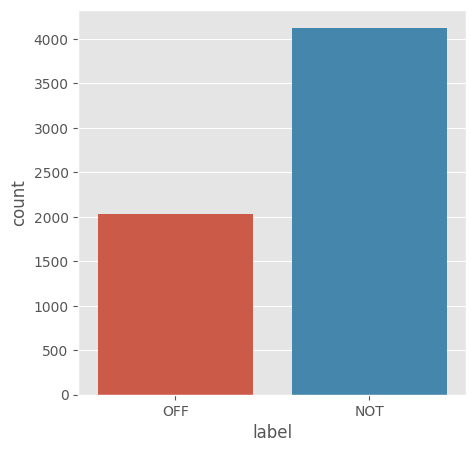

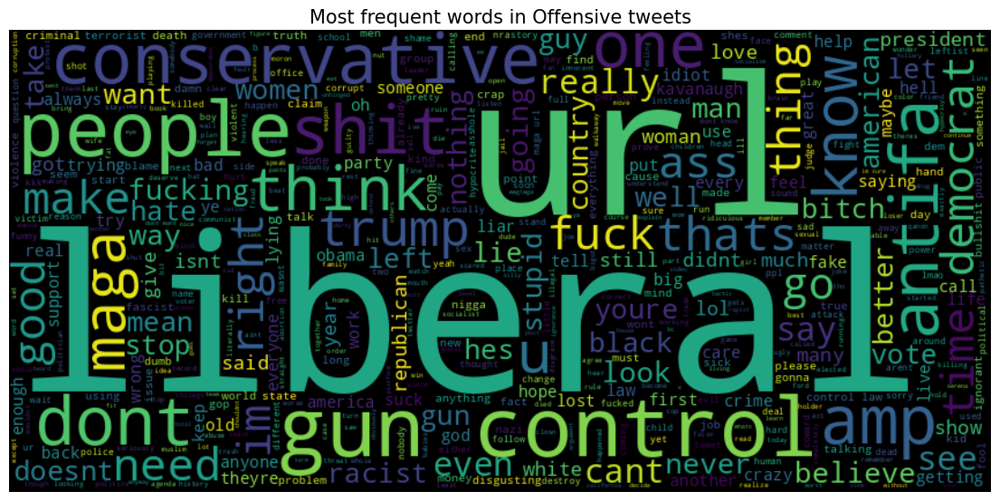

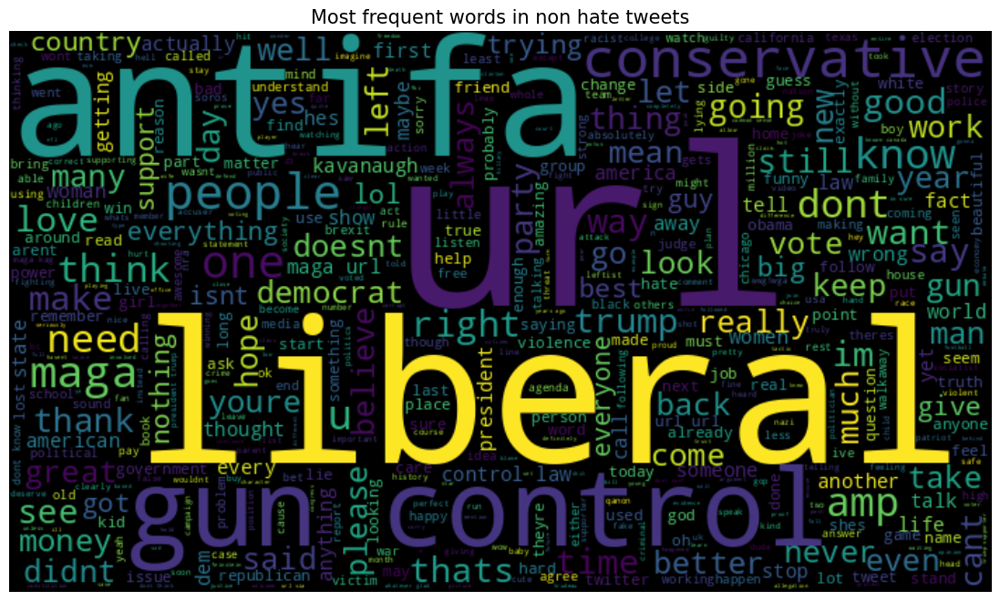

AFTER LOWERCASING :                                                tweet label
0  @user @user @user trump is declassifying infor...   NOT
1  @user ha even with them trying to rig the syst...   NOT
2  @user @user @user man you really thought this ...   NOT
3  @user ms. clinton - you are a class act. my re...   OFF
4  @user it’s still here at 753. if someone did t...   NOT
___________________________________________________________
AFTER NOISE REMOVAL :                                                tweet label
0     trump is declassifying information and ther...   NOT
1   ha even with them trying to rig the system th...   NOT
2         man you really thought this was it huh url   NOT
3   ms clinton  you are a class act my response t...   OFF
4   its still here at 753 if someone did this to ...   NOT
___________________________________________________________
AFTER LEMMATIZATION :                                                tweet label
0     trump is declassifying information and ther

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


AFTER STOPWORD REMOVAL :                                                tweet label
0  trump declassifying information nothing subjec...   NOT
1  ha even trying rig system idea divine interven...   NOT
2                         man really thought huh url   NOT
3  ms clinton class act response idiot would like...   OFF
4    still 753 someone family shed enraged let loose   NOT
___________________________________________________________


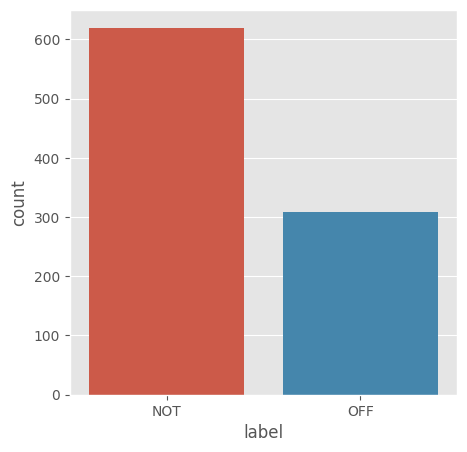

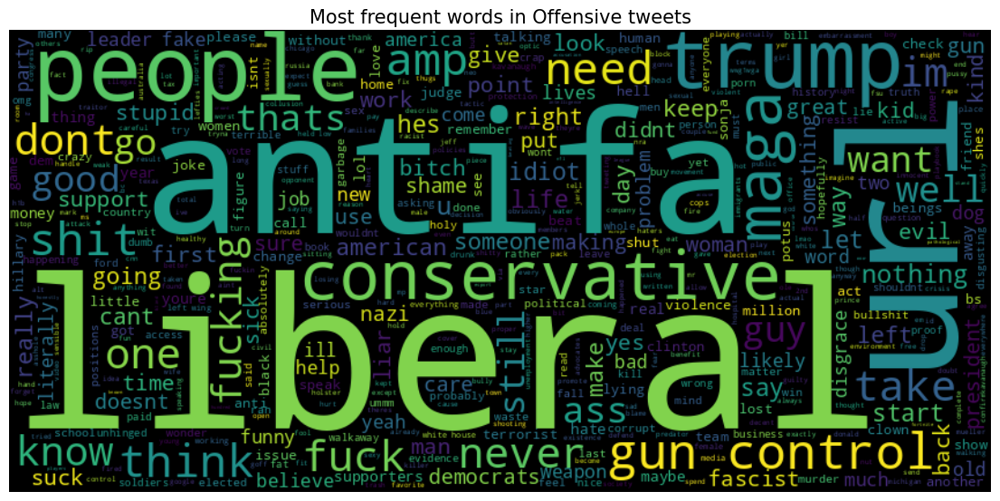

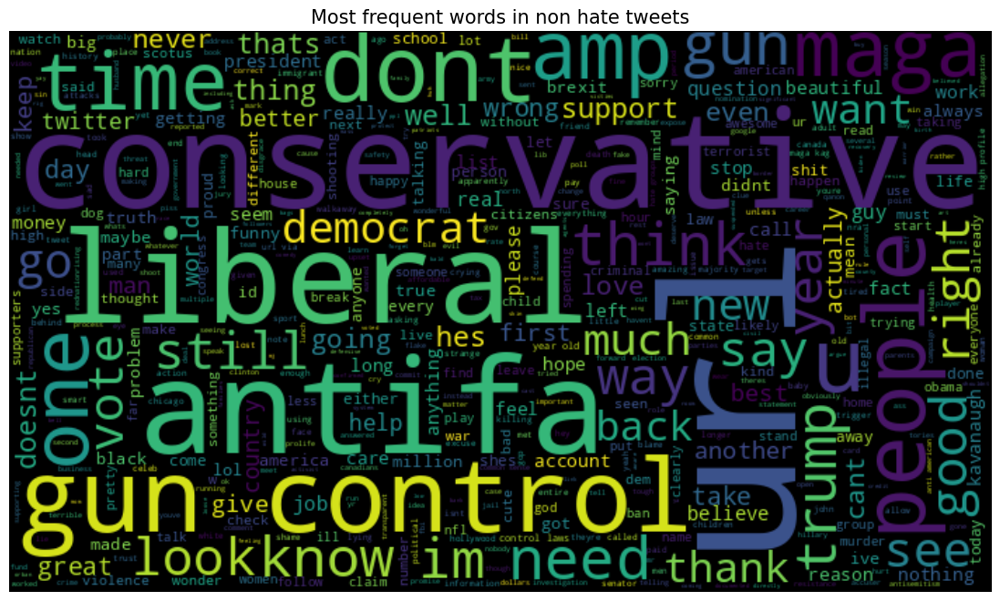

Let's start training using LogisticRegression
Best Cross validation score: 0.75
Best parameters:  {'C': 1.0, 'solver': 'liblinear'}
Saved model to  gdrive/MyDrive/./CE807/Assignment2/2201110/models/1/50/model.sav
Saved Vectorizer to  gdrive/MyDrive/./CE807/Assignment2/2201110/models/1/50/vectorizer.sav
Accuracy: 0.76
F1 score: 0.70
Recall: 0.6878
Precision: 0.7331
[[552  67]
 [159 149]]


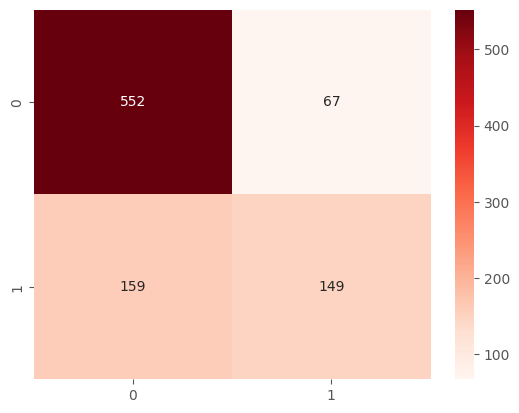

              precision    recall  f1-score   support

         NOT       0.78      0.89      0.83       619
         OFF       0.69      0.48      0.57       308

    accuracy                           0.76       927
   macro avg       0.73      0.69      0.70       927
weighted avg       0.75      0.76      0.74       927



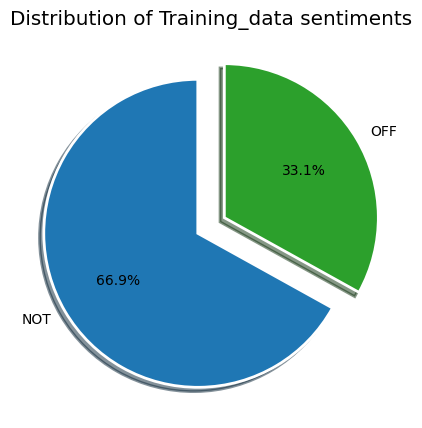

In [ ]:
print('Train using of 50% of data')
model_50_file, vectorizer_50_file,f1score,valid_accuracy = train_method1(train_50_file, val_file, MODEL_1_50_DIRECTORY)
valid_accuracy_list.append(valid_accuracy)
f1scorelist.append(f1score)

**LETS TRAIN USING 75%**

Train using of 75% of data
Train data len:9234
Valid data len:927
AFTER LOWERCASING :                                                tweet label
0  @user that was awesome. i love hearing you des...   OFF
1               @user conspiracy theories abound....   NOT
2  #toxictory minister @user attempted to expense...   NOT
3  @user lol religion of peace" am i right fellow...   NOT
4                           @user google go to hell!   OFF
___________________________________________________________
AFTER NOISE REMOVAL :                                                tweet label
0   that was awesome i love hearing you destroy t...   OFF
1                         conspiracy theories abound   NOT
2  #toxictory minister  attempted to expense 50 c...   NOT
3   lol religion of peace am i right fellow class...   NOT
4                                  google go to hell   OFF
___________________________________________________________
AFTER LEMMATIZATION :                                           

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


AFTER STOPWORD REMOVAL :                                                tweet label
0      awesome love hearing destroy liberals trudeau   OFF
1                         conspiracy theories abound   NOT
2  #toxictory minister attempted expense 50 chari...   NOT
3  lol religion peace right fellow classical libe...   NOT
4                                     google go hell   OFF
___________________________________________________________


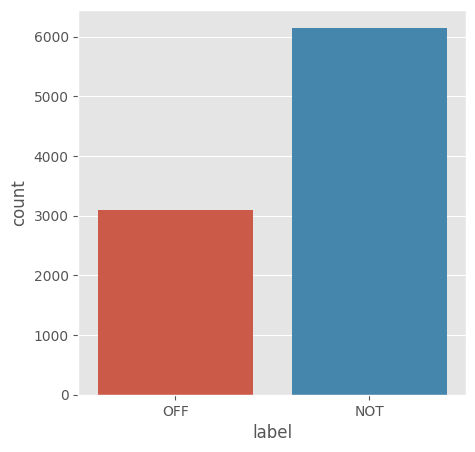

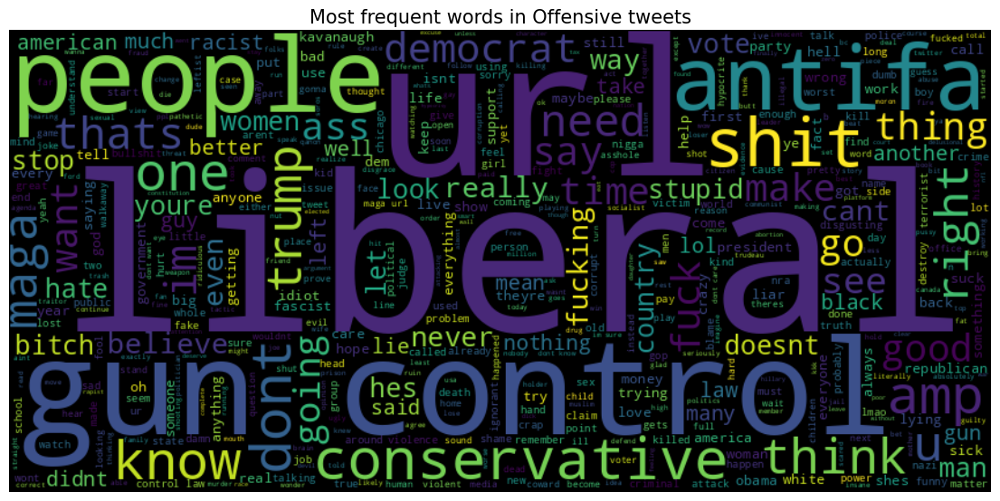

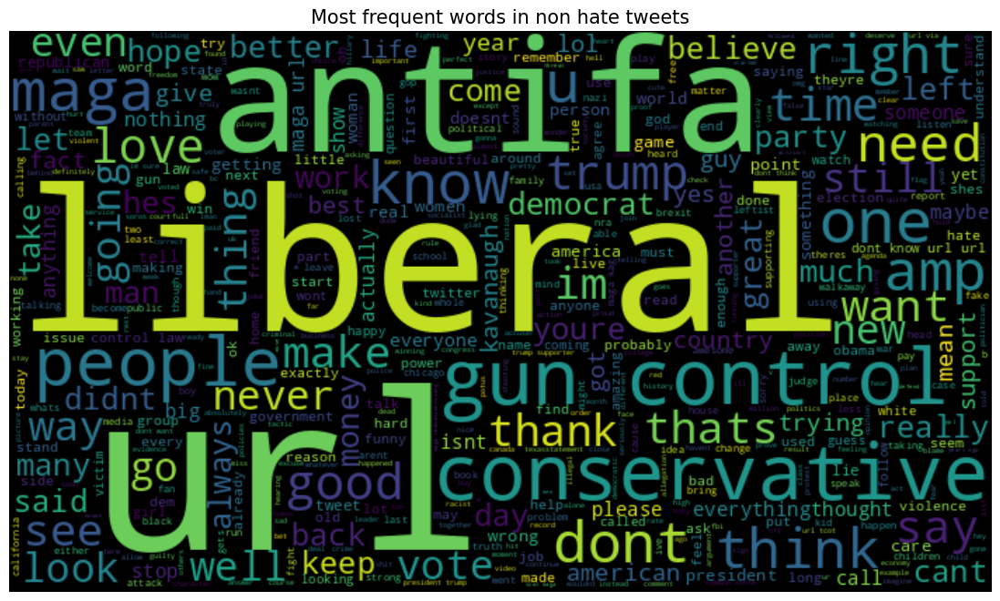

AFTER LOWERCASING :                                                tweet label
0  @user @user @user trump is declassifying infor...   NOT
1  @user ha even with them trying to rig the syst...   NOT
2  @user @user @user man you really thought this ...   NOT
3  @user ms. clinton - you are a class act. my re...   OFF
4  @user it’s still here at 753. if someone did t...   NOT
___________________________________________________________
AFTER NOISE REMOVAL :                                                tweet label
0     trump is declassifying information and ther...   NOT
1   ha even with them trying to rig the system th...   NOT
2         man you really thought this was it huh url   NOT
3   ms clinton  you are a class act my response t...   OFF
4   its still here at 753 if someone did this to ...   NOT
___________________________________________________________
AFTER LEMMATIZATION :                                                tweet label
0     trump is declassifying information and ther

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


AFTER STOPWORD REMOVAL :                                                tweet label
0  trump declassifying information nothing subjec...   NOT
1  ha even trying rig system idea divine interven...   NOT
2                         man really thought huh url   NOT
3  ms clinton class act response idiot would like...   OFF
4    still 753 someone family shed enraged let loose   NOT
___________________________________________________________


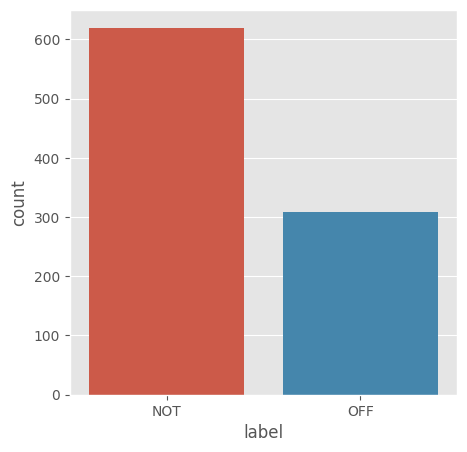

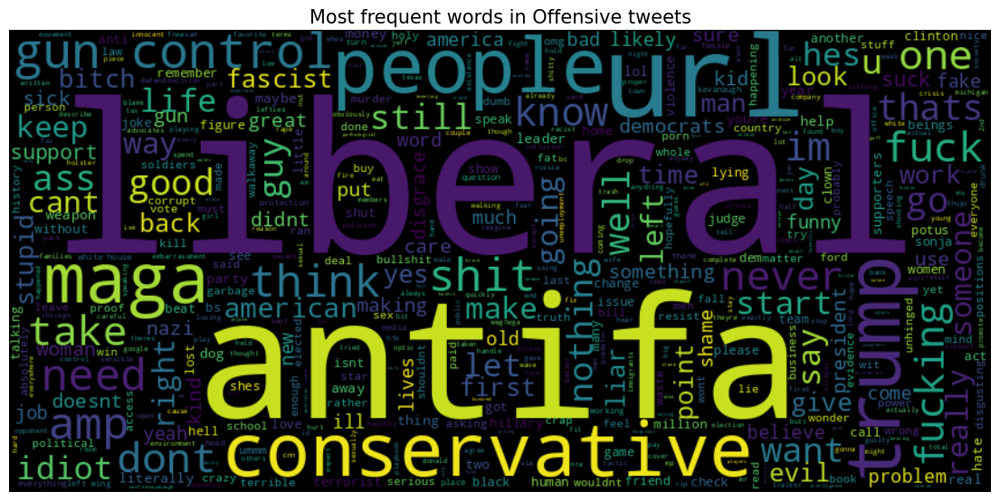

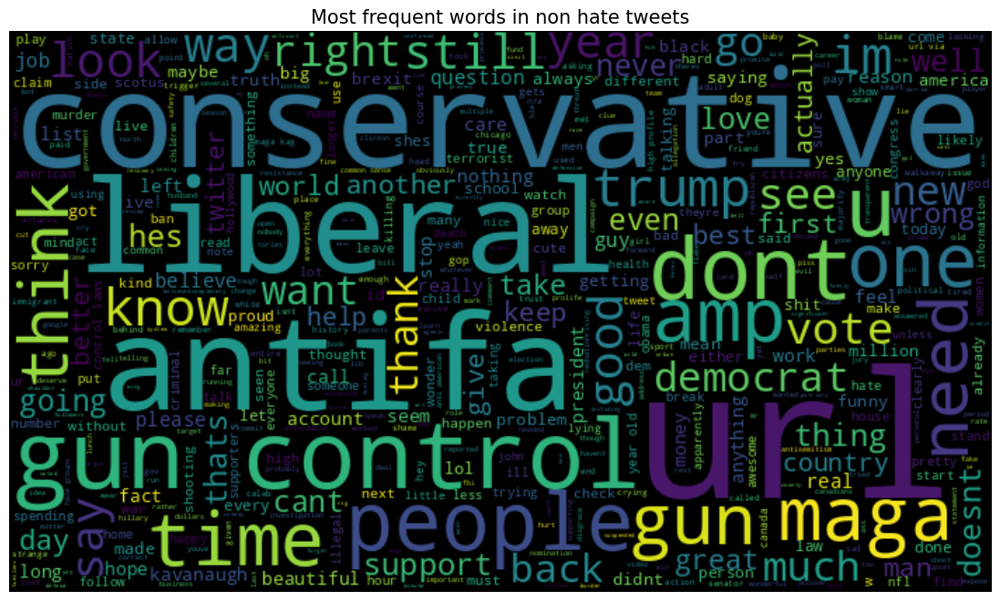

Let's start training using LogisticRegression
Best Cross validation score: 0.76
Best parameters:  {'C': 1.0, 'solver': 'liblinear'}
Saved model to  gdrive/MyDrive/./CE807/Assignment2/2201110/models/1/75/model.sav
Saved Vectorizer to  gdrive/MyDrive/./CE807/Assignment2/2201110/models/1/75/vectorizer.sav
Accuracy: 0.74
F1 score: 0.69
Recall: 0.6772
Precision: 0.7152
[[543  76]
 [161 147]]


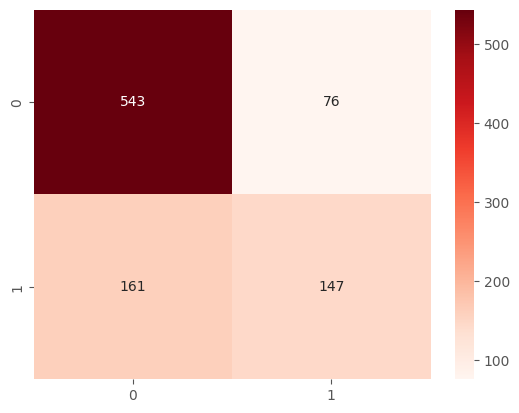

              precision    recall  f1-score   support

         NOT       0.77      0.88      0.82       619
         OFF       0.66      0.48      0.55       308

    accuracy                           0.74       927
   macro avg       0.72      0.68      0.69       927
weighted avg       0.73      0.74      0.73       927



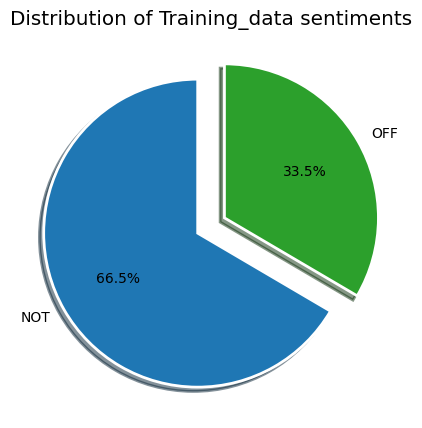

In [ ]:
print('Train using of 75% of data')
model_75_file, vectorizer_75_file,f1score,valid_accuracy = train_method1(train_75_file, val_file, MODEL_1_75_DIRECTORY)
valid_accuracy_list.append(valid_accuracy)
f1scorelist.append(f1score)

**LETS TRAIN USING 100%**

Train using of 100% of data
Train data len:12313
Valid data len:927
AFTER LOWERCASING :                                                tweet label
0  @user that was awesome. i love hearing you des...   OFF
1               @user conspiracy theories abound....   NOT
2  #toxictory minister @user attempted to expense...   NOT
3  @user lol religion of peace" am i right fellow...   NOT
4                           @user google go to hell!   OFF
___________________________________________________________
AFTER NOISE REMOVAL :                                                tweet label
0   that was awesome i love hearing you destroy t...   OFF
1                         conspiracy theories abound   NOT
2  #toxictory minister  attempted to expense 50 c...   NOT
3   lol religion of peace am i right fellow class...   NOT
4                                  google go to hell   OFF
___________________________________________________________
AFTER LEMMATIZATION :                                         

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


AFTER STOPWORD REMOVAL :                                                tweet label
0      awesome love hearing destroy liberals trudeau   OFF
1                         conspiracy theories abound   NOT
2  #toxictory minister attempted expense 50 chari...   NOT
3  lol religion peace right fellow classical libe...   NOT
4                                     google go hell   OFF
___________________________________________________________


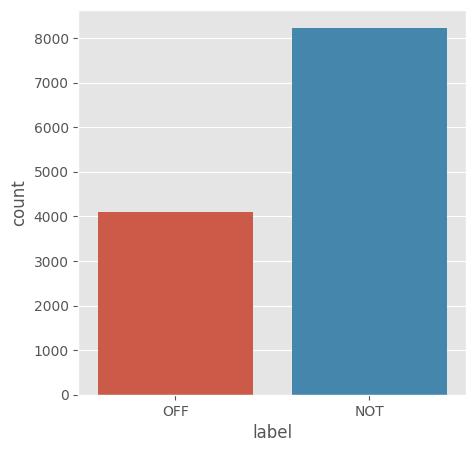

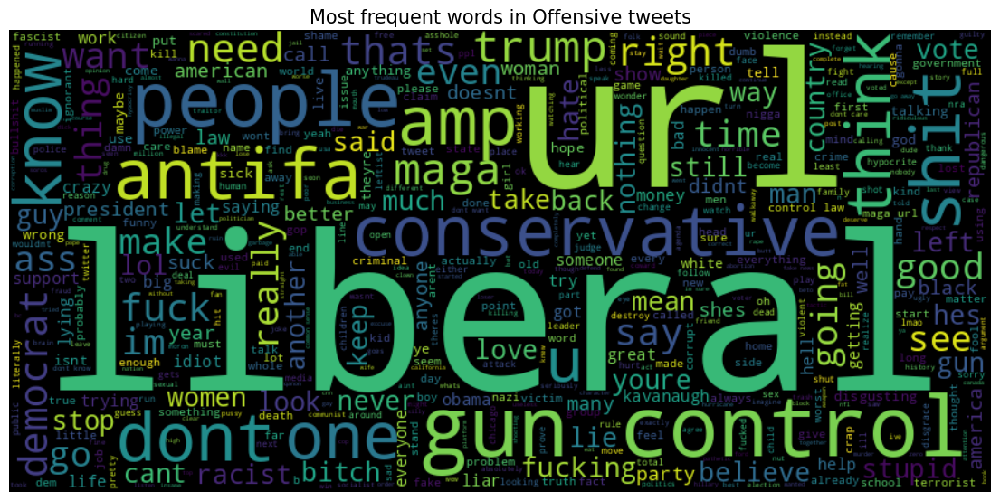

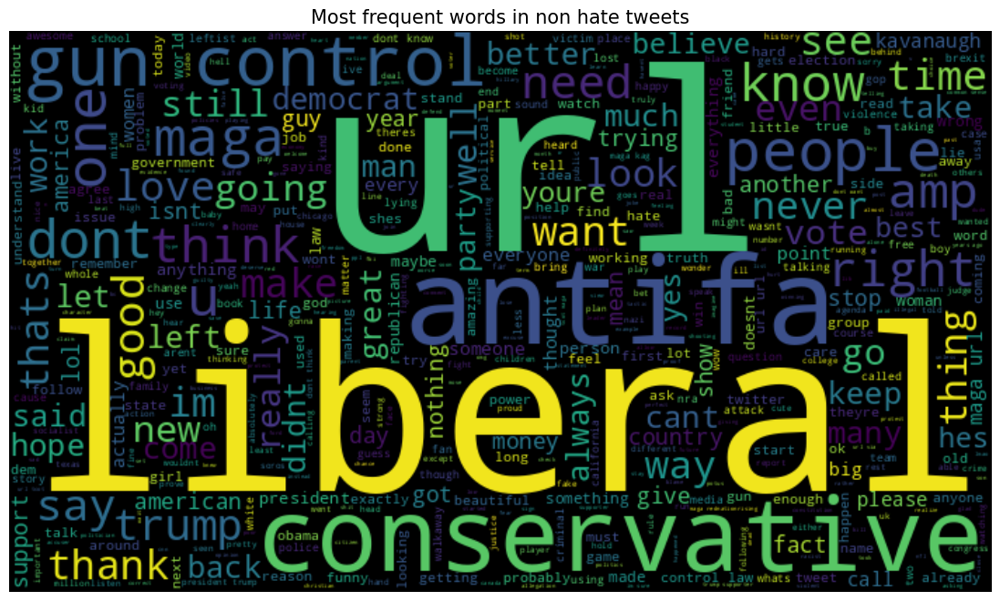

AFTER LOWERCASING :                                                tweet label
0  @user @user @user trump is declassifying infor...   NOT
1  @user ha even with them trying to rig the syst...   NOT
2  @user @user @user man you really thought this ...   NOT
3  @user ms. clinton - you are a class act. my re...   OFF
4  @user it’s still here at 753. if someone did t...   NOT
___________________________________________________________
AFTER NOISE REMOVAL :                                                tweet label
0     trump is declassifying information and ther...   NOT
1   ha even with them trying to rig the system th...   NOT
2         man you really thought this was it huh url   NOT
3   ms clinton  you are a class act my response t...   OFF
4   its still here at 753 if someone did this to ...   NOT
___________________________________________________________
AFTER LEMMATIZATION :                                                tweet label
0     trump is declassifying information and ther

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


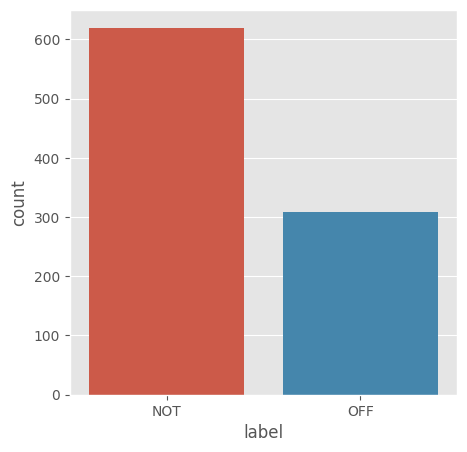

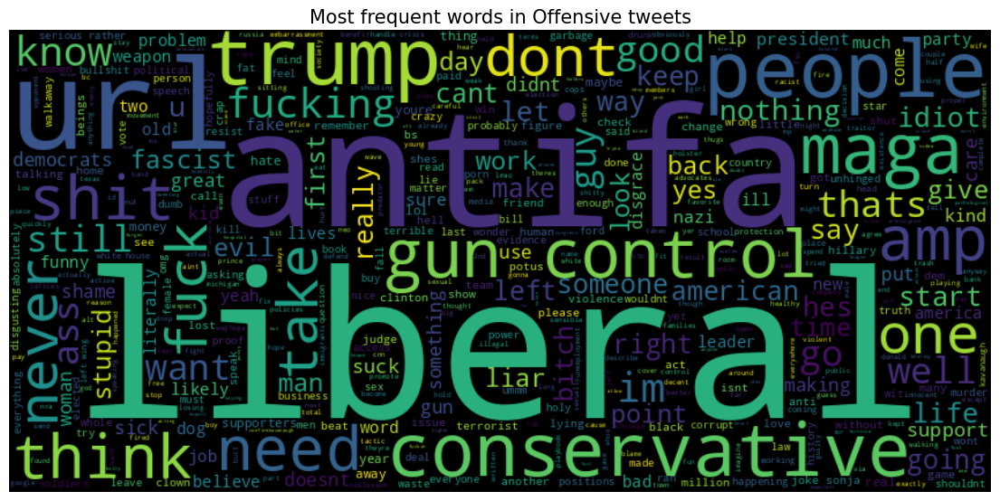

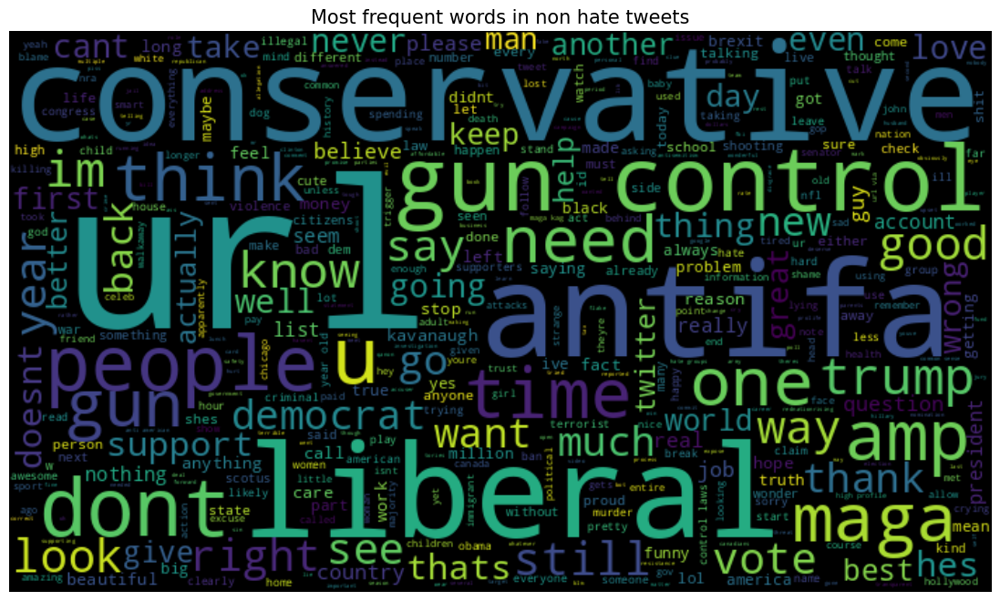

Let's start training using LogisticRegression
Best Cross validation score: 0.76
Best parameters:  {'C': 1.0, 'solver': 'liblinear'}
Saved model to  gdrive/MyDrive/./CE807/Assignment2/2201110/models/1/100/model.sav
Saved Vectorizer to  gdrive/MyDrive/./CE807/Assignment2/2201110/models/1/100/vectorizer.sav
Accuracy: 0.75
F1 score: 0.70
Recall: 0.6853
Precision: 0.7301
[[551  68]
 [160 148]]


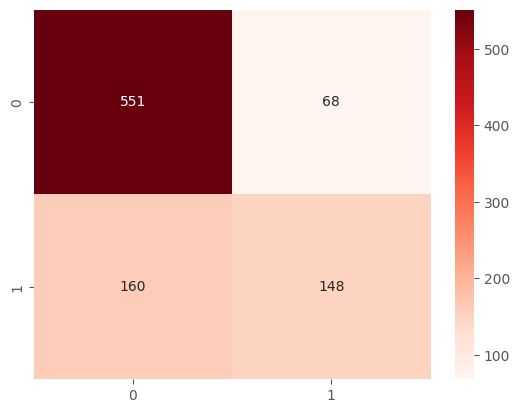

              precision    recall  f1-score   support

         NOT       0.77      0.89      0.83       619
         OFF       0.69      0.48      0.56       308

    accuracy                           0.75       927
   macro avg       0.73      0.69      0.70       927
weighted avg       0.75      0.75      0.74       927



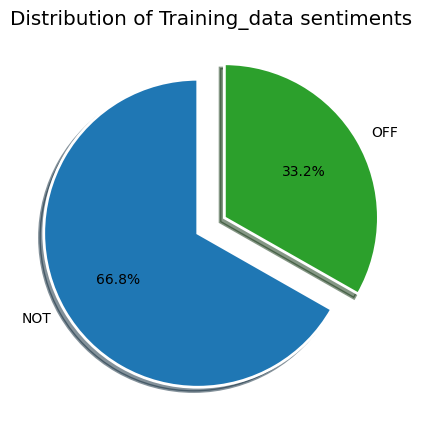

In [ ]:
print('Train using of 100% of data')
import pickle
model_100_file, vectorizer_100_file,f1score,valid_accuracy = train_method1(train_100, val_file, MODEL_1_100_DIRECTORY)
valid_accuracy_list.append(valid_accuracy)
f1scorelist.append(f1score)


**Load model and count vectorizer as pickel from GDrive**

In [ ]:
def load_model1(model_file, vectorizer_file):
    # load model and vectorizer from disk
    model = pickle.load(open(model_file, 'rb'))
    vectorizer = pickle.load(open(vectorizer_file, 'rb'))
    print('Loaded Vectorizer from ', vectorizer_file)
    return model, vectorizer

 **Save model and count vectorizer as pickel in GDrive**

In [ ]:
def save_model1(model, vectorizer, model_dir):
    # save the model to disk
    model_file = os.path.join(model_dir, 'model.sav')
    pickle.dump(model, open(model_file, 'wb'))

    print('Saved model to ', model_file)

    vectorizer_file = os.path.join(model_dir, 'vectorizer.sav')
    pickle.dump(vectorizer, open(vectorizer_file, 'wb'))

    print('Saved Vectorizer to ', vectorizer_file)

    return model_file, vectorizer_file

### **Testing Method 1 Code**
Your test code should be a stand alone code that must take `test_file`, `model_file` and `output_dir` as input. You could have other things as also input, but these three are must. You would load both files, and generate output based on inputs. Then you will `print` / `display`/ `plot` all performance metrics, and save the output file in the `output_dir`  

In [ ]:
def test_method1(test_file, model_file, vectorizer_file, output_dir):
    """
     take test_file, model_file and output_dir as input.
     It loads model and test of the examples in the test_file.
     It prints different evaluation metrics, and saves the output in output directory

     ADD Other arguments, if needed

    Args:
        test_file: Test file name
        model_file: Model file name
        vectorizer_file: Vectorizer file name
        output_dir: Output Directory

    """

    test_df = pd.read_csv(test_file)
    test_label = test_df['label']
    #Loading the model from the saved file
    model, vectorizer = load_model1(model_file, vectorizer_file)
    #Preprocessing the  testdataset
    test_values= prepare_dataset1(test_df,vectorizer)
    test_pred_label = model.predict(test_values)
    #Saving the predicted label as out label
    test_df['out_label']  = test_pred_label
    #Computing the performace of test file
    f1scoretest,valid_accuracytest= compute_performance(test_label, test_pred_label, split='test')
    #Saving it in the output file
    out_file = os.path.join(output_dir, 'output_test.csv')
    print('Saving model output to', out_file)
    test_df.to_csv(out_file)
    return f1scoretest,valid_accuracytest


**Let's test using model trained on 25% data.**

Note that here we are getting same results because it is trained using the dummy data, not actual 25% of data

Testing using model trained on 25% data
Loaded Vectorizer from  gdrive/MyDrive/./CE807/Assignment2/2201110/models/1/25/vectorizer.sav
AFTER LOWERCASING :                                                tweet label
0  #whoisq #wherestheserver #dumpnike #declasfisa...   OFF
1  #constitutionday is revered by conservatives, ...   NOT
2  #foxnews #nra #maga #potus #trump #2ndamendmen...   NOT
3  #watching #boomer getting the news that she is...   NOT
4  #nopasaran: unity demo to oppose the far-right...   OFF
___________________________________________________________
AFTER NOISE REMOVAL :                                                tweet label
0  #whoisq #wherestheserver #dumpnike #declasfisa...   OFF
1  #constitutionday is revered by conservatives h...   NOT
2  #foxnews #nra #maga #potus #trump #2ndamendmen...   NOT
3  #watching #boomer getting the news that she is...   NOT
4  #nopasaran unity demo to oppose the farright i...   OFF
________________________________________________________

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


AFTER STOPWORD REMOVAL :                                                tweet label
0  #whoisq #wherestheserver #dumpnike #declasfisa...   OFF
1  #constitutionday revered conservatives hated p...   NOT
2  #foxnews #nra #maga #potus #trump #2ndamendmen...   NOT
3  #watching #boomer getting news still parole al...   NOT
4  #nopasaran unity demo oppose farright #london ...   OFF
___________________________________________________________


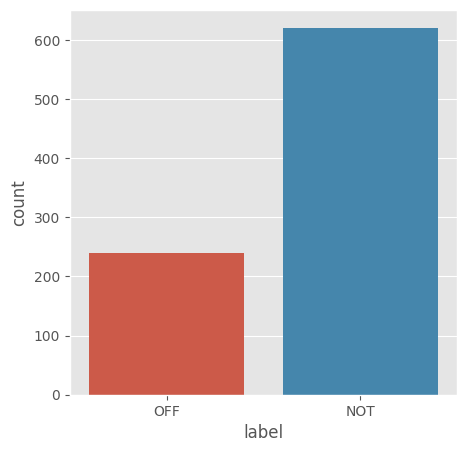

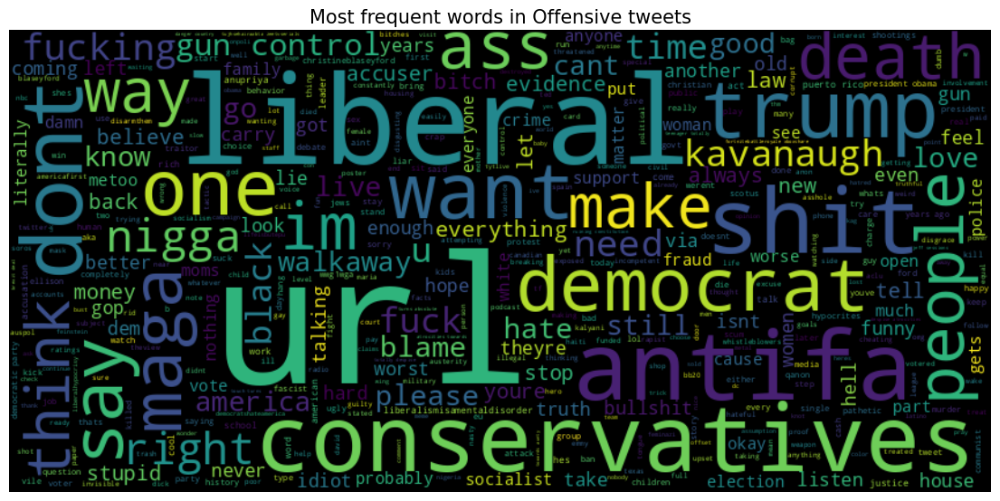

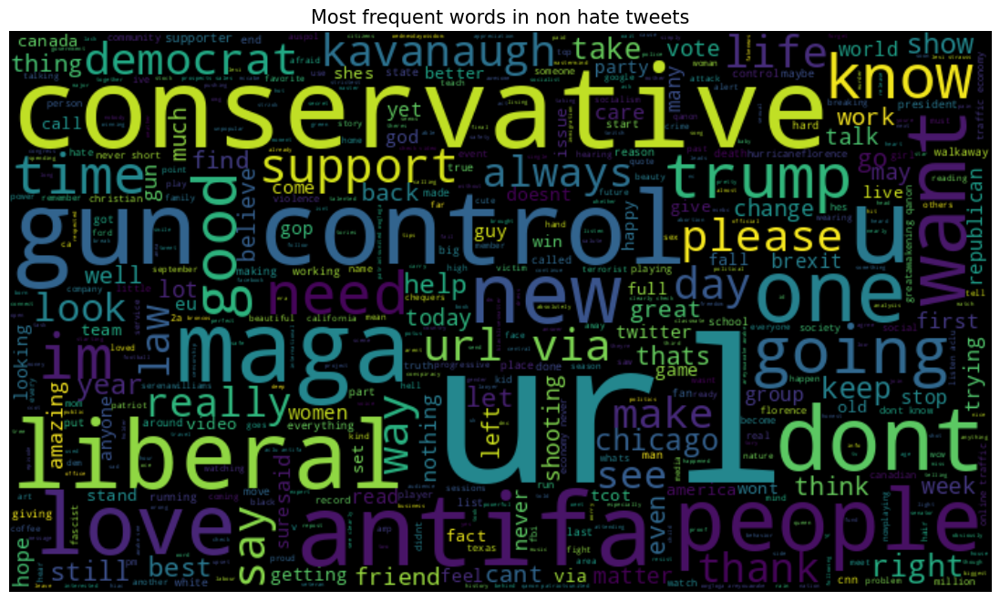

Accuracy: 0.77
F1 score: 0.67
Recall: 0.6560
Precision: 0.7214
[[568  52]
 [145  95]]


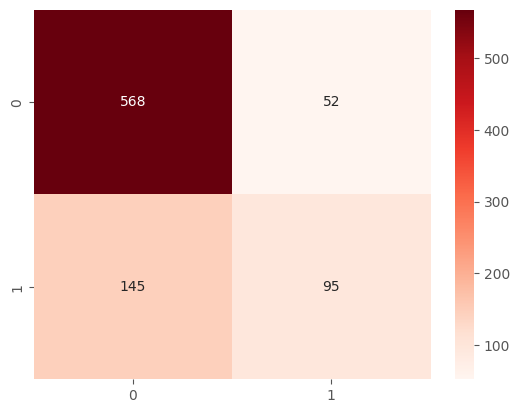

              precision    recall  f1-score   support

         NOT       0.80      0.92      0.85       620
         OFF       0.65      0.40      0.49       240

    accuracy                           0.77       860
   macro avg       0.72      0.66      0.67       860
weighted avg       0.75      0.77      0.75       860

Saving model output to gdrive/MyDrive/./CE807/Assignment2/2201110/models/1/25/output_test.csv


In [ ]:
print('Testing using model trained on 25% data')
f1_test_list=[]
accuracy_test_list=[]
f1scoretest,valid_accuracytest=test_method1(test_file, model_25_file, vectorizer_25_file, MODEL_1_25_DIRECTORY)
accuracy_test_list.append(valid_accuracytest)
f1_test_list.append(f1scoretest)

**TESTING ON 50% DATA**

Testing using model trained on 50% data
Loaded Vectorizer from  gdrive/MyDrive/./CE807/Assignment2/2201110/models/1/50/vectorizer.sav
AFTER LOWERCASING :                                                tweet label
0  #whoisq #wherestheserver #dumpnike #declasfisa...   OFF
1  #constitutionday is revered by conservatives, ...   NOT
2  #foxnews #nra #maga #potus #trump #2ndamendmen...   NOT
3  #watching #boomer getting the news that she is...   NOT
4  #nopasaran: unity demo to oppose the far-right...   OFF
___________________________________________________________
AFTER NOISE REMOVAL :                                                tweet label
0  #whoisq #wherestheserver #dumpnike #declasfisa...   OFF
1  #constitutionday is revered by conservatives h...   NOT
2  #foxnews #nra #maga #potus #trump #2ndamendmen...   NOT
3  #watching #boomer getting the news that she is...   NOT
4  #nopasaran unity demo to oppose the farright i...   OFF
________________________________________________________

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


AFTER STOPWORD REMOVAL :                                                tweet label
0  #whoisq #wherestheserver #dumpnike #declasfisa...   OFF
1  #constitutionday revered conservatives hated p...   NOT
2  #foxnews #nra #maga #potus #trump #2ndamendmen...   NOT
3  #watching #boomer getting news still parole al...   NOT
4  #nopasaran unity demo oppose farright #london ...   OFF
___________________________________________________________


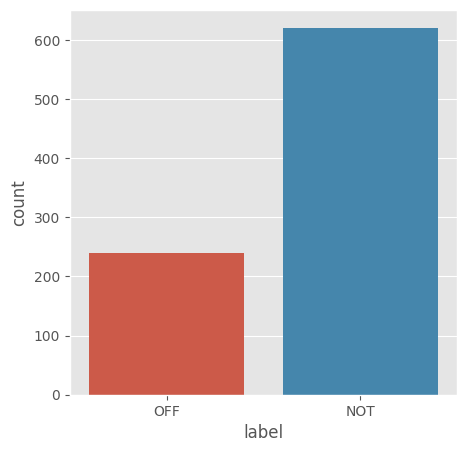

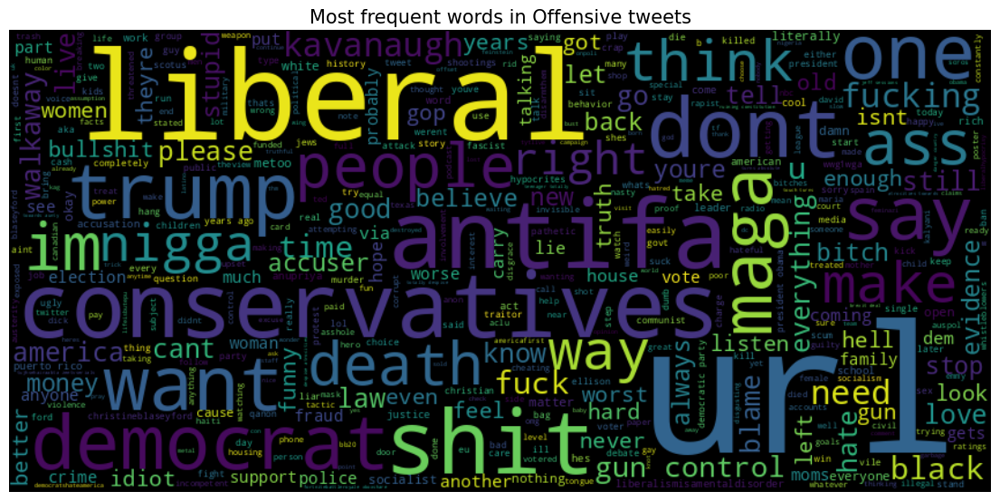

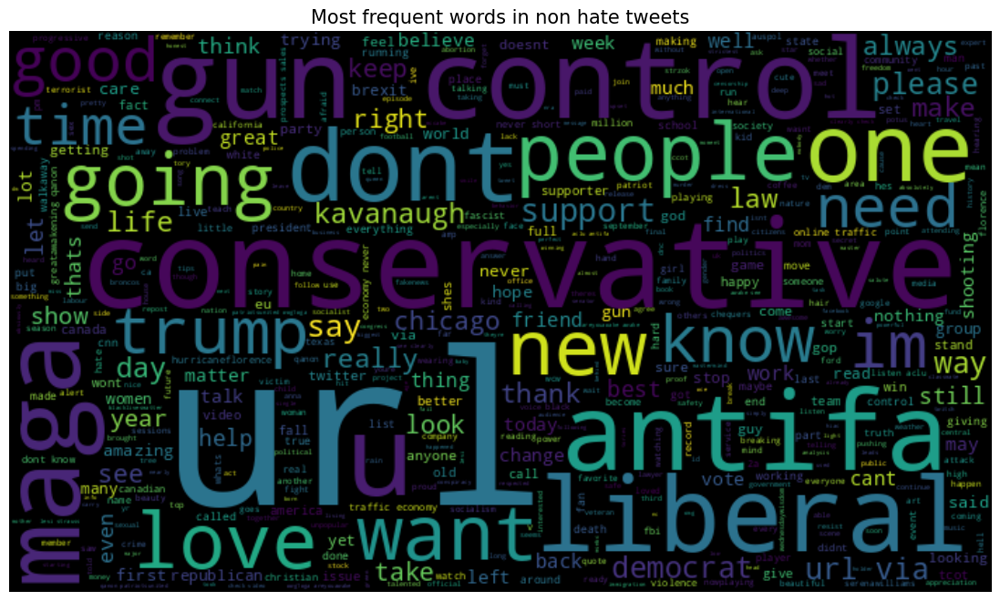

Accuracy: 0.78
F1 score: 0.68
Recall: 0.6677
Precision: 0.7295
[[567  53]
 [139 101]]


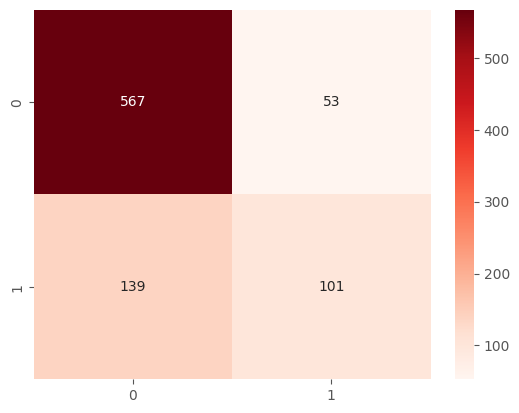

              precision    recall  f1-score   support

         NOT       0.80      0.91      0.86       620
         OFF       0.66      0.42      0.51       240

    accuracy                           0.78       860
   macro avg       0.73      0.67      0.68       860
weighted avg       0.76      0.78      0.76       860

Saving model output to gdrive/MyDrive/./CE807/Assignment2/2201110/models/1/50/output_test.csv


In [ ]:
print('Testing using model trained on 50% data')
f1scoretest,valid_accuracytest=test_method1(test_file, model_50_file, vectorizer_50_file, MODEL_1_50_DIRECTORY)
accuracy_test_list.append(valid_accuracytest)
f1_test_list.append(f1scoretest)

**TESTING ON 75% DATA**

Testing using model trained on 75% data
Loaded Vectorizer from  gdrive/MyDrive/./CE807/Assignment2/2201110/models/1/75/vectorizer.sav
AFTER LOWERCASING :                                                tweet label
0  #whoisq #wherestheserver #dumpnike #declasfisa...   OFF
1  #constitutionday is revered by conservatives, ...   NOT
2  #foxnews #nra #maga #potus #trump #2ndamendmen...   NOT
3  #watching #boomer getting the news that she is...   NOT
4  #nopasaran: unity demo to oppose the far-right...   OFF
___________________________________________________________
AFTER NOISE REMOVAL :                                                tweet label
0  #whoisq #wherestheserver #dumpnike #declasfisa...   OFF
1  #constitutionday is revered by conservatives h...   NOT
2  #foxnews #nra #maga #potus #trump #2ndamendmen...   NOT
3  #watching #boomer getting the news that she is...   NOT
4  #nopasaran unity demo to oppose the farright i...   OFF
________________________________________________________

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


AFTER STOPWORD REMOVAL :                                                tweet label
0  #whoisq #wherestheserver #dumpnike #declasfisa...   OFF
1  #constitutionday revered conservatives hated p...   NOT
2  #foxnews #nra #maga #potus #trump #2ndamendmen...   NOT
3  #watching #boomer getting news still parole al...   NOT
4  #nopasaran unity demo oppose farright #london ...   OFF
___________________________________________________________


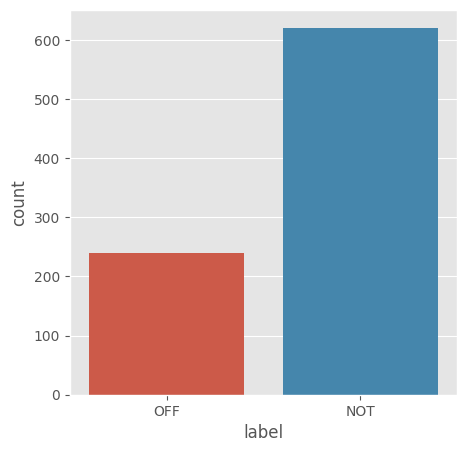

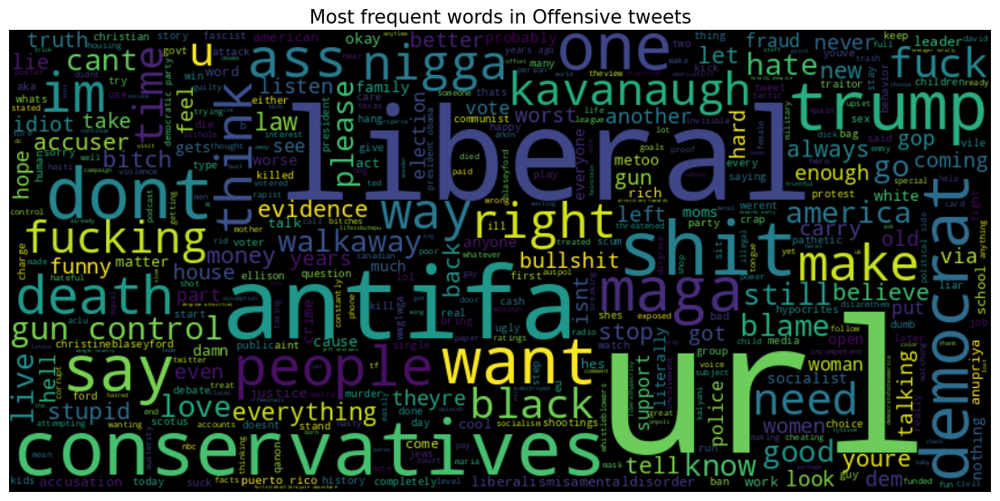

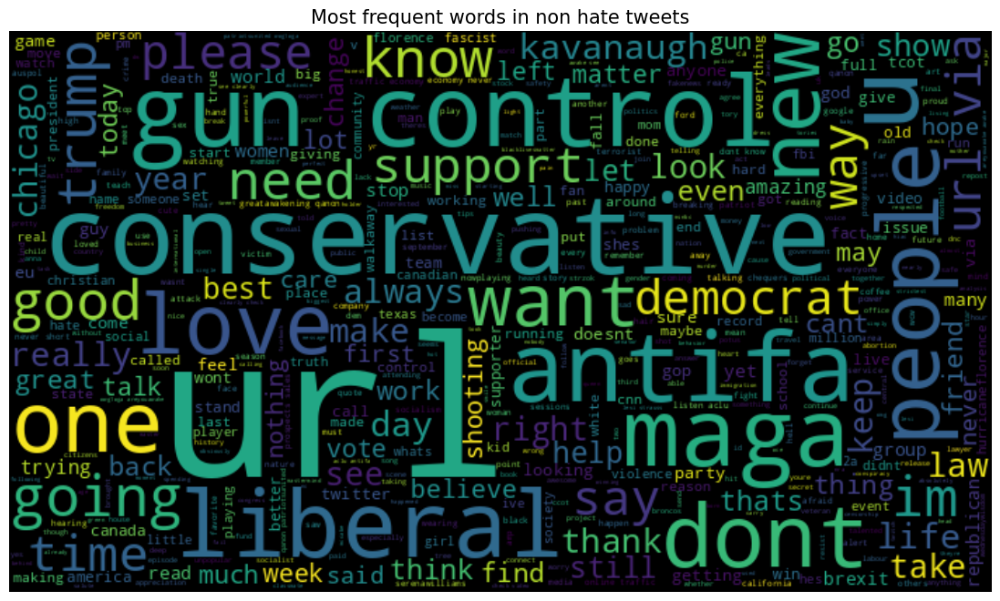

Accuracy: 0.80
F1 score: 0.72
Recall: 0.7010
Precision: 0.7550
[[567  53]
 [123 117]]


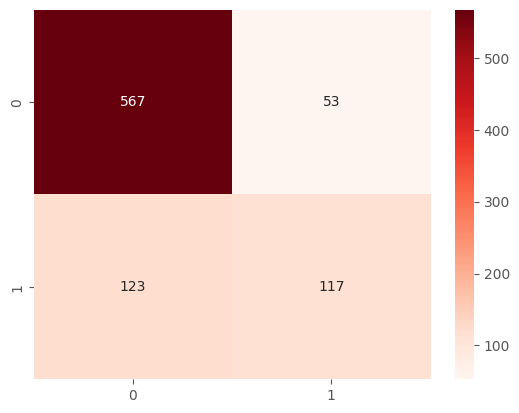

              precision    recall  f1-score   support

         NOT       0.82      0.91      0.87       620
         OFF       0.69      0.49      0.57       240

    accuracy                           0.80       860
   macro avg       0.75      0.70      0.72       860
weighted avg       0.78      0.80      0.78       860

Saving model output to gdrive/MyDrive/./CE807/Assignment2/2201110/models/1/75/output_test.csv


In [ ]:
print('Testing using model trained on 75% data')
f1scoretest,valid_accuracytest=test_method1(test_file, model_75_file, vectorizer_75_file, MODEL_1_75_DIRECTORY)
accuracy_test_list.append(valid_accuracytest)
f1_test_list.append(f1scoretest)

**Let's test using model trained on 100% data**

Testing using model trained on 100% data
Loaded Vectorizer from  gdrive/MyDrive/./CE807/Assignment2/2201110/models/1/100/vectorizer.sav
AFTER LOWERCASING :                                                tweet label
0  #whoisq #wherestheserver #dumpnike #declasfisa...   OFF
1  #constitutionday is revered by conservatives, ...   NOT
2  #foxnews #nra #maga #potus #trump #2ndamendmen...   NOT
3  #watching #boomer getting the news that she is...   NOT
4  #nopasaran: unity demo to oppose the far-right...   OFF
___________________________________________________________
AFTER NOISE REMOVAL :                                                tweet label
0  #whoisq #wherestheserver #dumpnike #declasfisa...   OFF
1  #constitutionday is revered by conservatives h...   NOT
2  #foxnews #nra #maga #potus #trump #2ndamendmen...   NOT
3  #watching #boomer getting the news that she is...   NOT
4  #nopasaran unity demo to oppose the farright i...   OFF
______________________________________________________

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


AFTER STOPWORD REMOVAL :                                                tweet label
0  #whoisq #wherestheserver #dumpnike #declasfisa...   OFF
1  #constitutionday revered conservatives hated p...   NOT
2  #foxnews #nra #maga #potus #trump #2ndamendmen...   NOT
3  #watching #boomer getting news still parole al...   NOT
4  #nopasaran unity demo oppose farright #london ...   OFF
___________________________________________________________


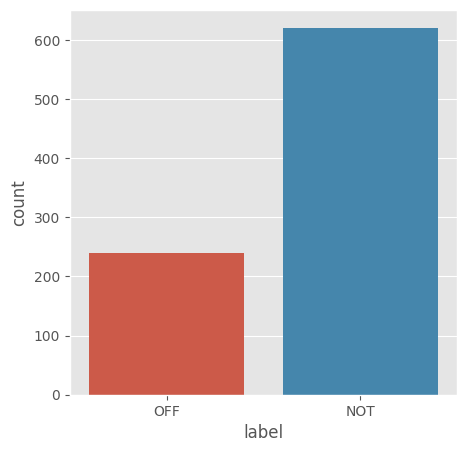

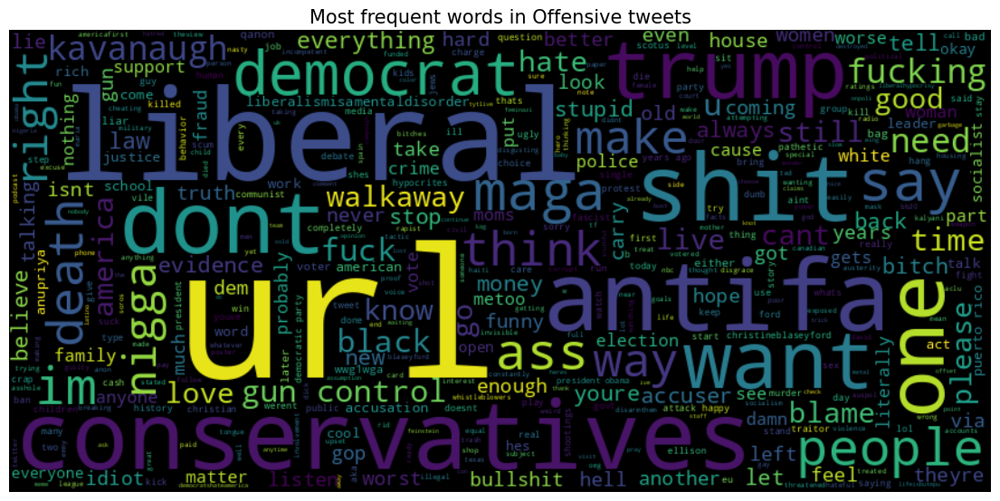

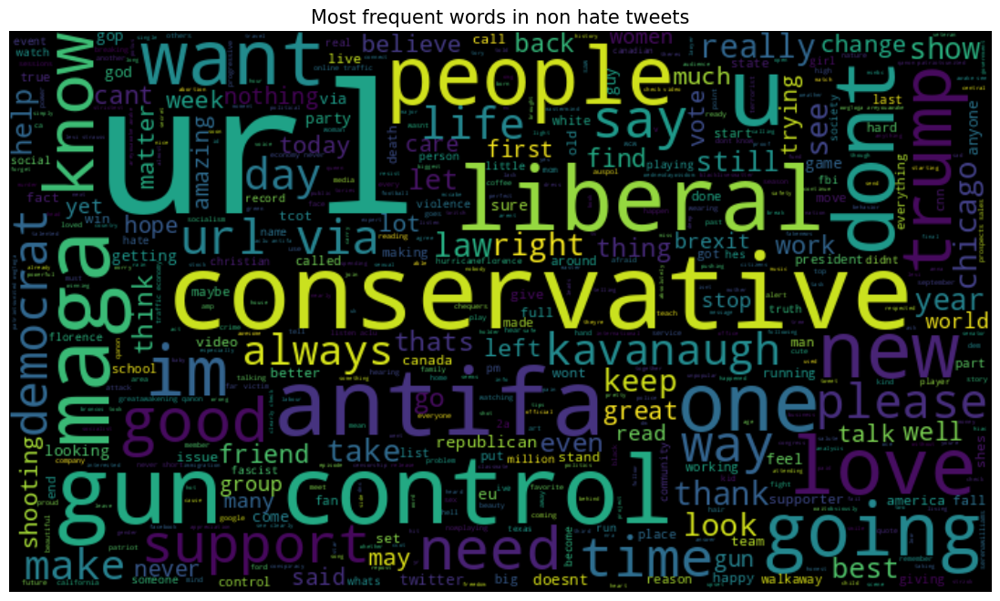

Accuracy: 0.80
F1 score: 0.72
Recall: 0.6980
Precision: 0.7593
[[571  49]
 [126 114]]


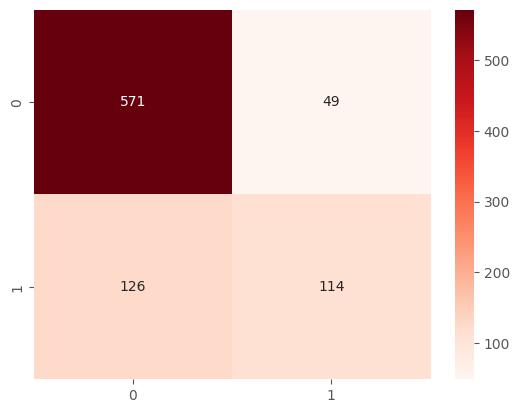

              precision    recall  f1-score   support

         NOT       0.82      0.92      0.87       620
         OFF       0.70      0.47      0.57       240

    accuracy                           0.80       860
   macro avg       0.76      0.70      0.72       860
weighted avg       0.79      0.80      0.78       860

Saving model output to gdrive/MyDrive/./CE807/Assignment2/2201110/models/1/100/output_test.csv


In [ ]:
print('Testing using model trained on 100% data')
f1scoretest,valid_accuracytest=test_method1(test_file, model_100_file, vectorizer_100_file, MODEL_1_100_DIRECTORY)
accuracy_test_list.append(valid_accuracytest)
f1_test_list.append(f1scoretest)


# **Data Visualization**

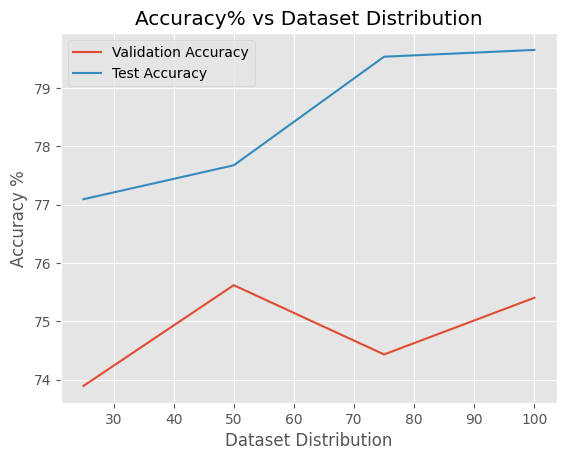

In [ ]:
# Define the dataset sizes to be plotted
dataset_sizes = [25, 50, 75, 100]
# Plot the validation accuracy against the dataset sizes
plt.plot(dataset_sizes, valid_accuracy_list, label='Validation Accuracy')
# Plot the test accuracy against the dataset sizes
plt.plot(dataset_sizes, accuracy_test_list, label='Test Accuracy')
# Set the labels and title for the plot
plt.xlabel('Dataset Distribution')
plt.ylabel('Accuracy %')
plt.title('Accuracy% vs Dataset Distribution')
# Set the legend for the plot
plt.legend()
# Display the plot
plt.show()


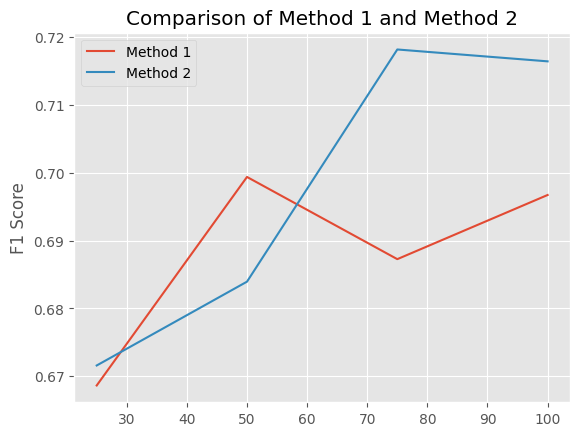

[0.6686351550960119, 0.6993887390231304, 0.6872669971943579, 0.6967284623773174] [0.6715845628073684, 0.6839469876197257, 0.7181902811394527, 0.7164395356768051]


In [ ]:
# Plot graph
dataset_sizes = [25, 50, 75, 100]
plt.plot(dataset_sizes, f1scorelist, label='Method 1')
plt.plot(dataset_sizes, f1_test_list, label='Method 2')
#plt.xlabel('Dataset Distribution')
plt.ylabel('F1 Score')
plt.title('Comparison of Method 1 and Method 2')
plt.legend()
plt.show()
print(f1scorelist,f1_test_list)

### **METHOD 1 END**

# **Creating file directory for Model 2**

In [ ]:

MODEL_2_DIRECTORY = os.path.join(GOOGLE_DRIVE_PATH, 'models', '2') # Model 2 directory
print('Model 2 directory: ', MODEL_2_DIRECTORY)


MODEL_2_25_DIRECTORY = os.path.join(MODEL_2_DIRECTORY,'25') # Model 2 trained using 25% of train data directory
print('Model 2 directory with 25% data: ', MODEL_2_25_DIRECTORY)

model_2_25_output_test_file = os.path.join(MODEL_2_25_DIRECTORY, 'output_test.csv') # Output file using Model 2 trained using 25% of train data
print('Output file name using model 2 using 25% of train data: ',model_2_25_output_test_file)


MODEL_2_50_DIRECTORY = os.path.join(MODEL_2_DIRECTORY,'50') # Model 2 trained using 50% of train data directory
print('Model 2 directory with 50% data: ', MODEL_2_50_DIRECTORY)

model_2_50_output_test_file = os.path.join(MODEL_2_50_DIRECTORY, 'output_test.csv') # Output file using Model 2 trained using 50% of train data
print('Output file name using model 2 using 50% of train data: ',model_2_50_output_test_file)


MODEL_2_75_DIRECTORY = os.path.join(MODEL_2_DIRECTORY,'75') # Model 1 trained using 75% of train data directory
print('Model 2 directory with 75% data: ', MODEL_2_75_DIRECTORY)

model_2_75_output_test_file = os.path.join(MODEL_2_75_DIRECTORY, 'output_test.csv') # Output file using Model 2 trained using 75% of train data
print('Output file name using model 2 using 75% of train data: ',model_2_75_output_test_file)


MODEL_2_100_DIRECTORY = os.path.join(MODEL_2_DIRECTORY,'100') # Model 2 trained using 100% of train data directory
print('Model 2 directory with 100% data: ', MODEL_2_100_DIRECTORY)

model_2_100_output_test_file = os.path.join(MODEL_2_100_DIRECTORY, 'output_test.csv')
print('Output file name using model 2 using 100% of train data: ',model_2_100_output_test_file)

Model 2 directory:  gdrive/MyDrive/./CE807/Assignment2/2201110/models/2
Model 2 directory with 25% data:  gdrive/MyDrive/./CE807/Assignment2/2201110/models/2/25
Output file name using model 2 using 25% of train data:  gdrive/MyDrive/./CE807/Assignment2/2201110/models/2/25/output_test.csv
Model 2 directory with 50% data:  gdrive/MyDrive/./CE807/Assignment2/2201110/models/2/50
Output file name using model 2 using 50% of train data:  gdrive/MyDrive/./CE807/Assignment2/2201110/models/2/50/output_test.csv
Model 2 directory with 75% data:  gdrive/MyDrive/./CE807/Assignment2/2201110/models/2/75
Output file name using model 2 using 75% of train data:  gdrive/MyDrive/./CE807/Assignment2/2201110/models/2/75/output_test.csv
Model 2 directory with 100% data:  gdrive/MyDrive/./CE807/Assignment2/2201110/models/2/100
Output file name using model 2 using 100% of train data:  gdrive/MyDrive/./CE807/Assignment2/2201110/models/2/100/output_test.csv


## **Model 2:Convolutional Neural Network**

## **Method 2 start**

In this section you will write all details of your Method 2.

You will have to enter multiple `code` and `text` cell.

Your code should follow the standard ML pipeline


*   Data reading
*   Data clearning, if any
*   Convert data to vector/tokenization/vectorization
*   Model Declaration/Initialization/building
*   Training and validation of the model using training and validation dataset
*   Save the trained model
*   Load and Test the model on testing set
*   Save the output of the model

You could add any other step(s) based on your method's requirement.

After finishing the above, you need to usd splited data as defined in the assignment and then do the same for all 4 sets. Your code should not be copy-pasted 4 time, make use of `function`.


## Training Method 2 Code
Your test code should be a stand alone code that must take `train_file`, `val_file`,  and `model_dir` as input. You could have other things as also input, but these three are must. You would load both files, and train using the `train_file` and validating using the `val_file`. You will `print` / `display`/ `plot` all performance metrics, loss(if available) and save the output model in the `model_dir`.

Note that at the testing time, you need to use the same pre-processing and model. So, it would be good that you make those as seperate function/pipeline whichever it the best suited for your method. Don't copy-paste same code twice, make it a fucntion/class whichever is best.

### **Data Cleaning**

In [ ]:

def prepare_dataset2(train_1):
  #Loading the file
  train_df = pd.read_csv(train_1)

  #DROPPING DUPLICATES
  train_df=train_df.drop_duplicates('tweet')

  #Lowercasing: Changing all the letters to be lowercase.
  train_df['tweet'] = train_df['tweet'].str.lower()
  train_df.head()
  print("___________________________________________________________")

  # The following code replaces the label values in the train_df DataFrame.The 'NOT' label is replaced with 0 and the 'OFF' label is replaced with 1 to convert the
  #labels into a binary format for training purposes.
  train_df['label'] = train_df['label'] .replace('NOT',0)
  train_df['label']  = train_df['label'] .replace('OFF',1)
  train_df['label'] .head()
  print("___________________________________________________________")

  #Noise removal: Removing special characters (such as punctuations or a tweet starting with user).
  train_df['tweet'] = train_df['tweet'].apply(lambda x: re.sub(r'[^\w\s#@€™]', '', x))
  train_df['tweet'] = train_df['tweet'].apply(lambda y: re.sub(r'@user\w*\b', '', y))
  train_df['tweet'] = train_df['tweet'].apply(lambda x: re.sub(r'\buser\b', '', x))
  #Reducing the dimensionality of the dataset
  train_df=train_df.drop('id',axis=1)
  print("AFTER NOISE REMOVAL :",train_df.head() )
  print("___________________________________________________________")

  #Removing Noise from the data
  #Removing emoticons
  def remove_emoticons(text):
    emoji_pattern = re.compile("["
                           u"\U0001F600-\U0001F64F"
                           u"\U0001F300-\U0001F5FF"
                           u"\U0001F680-\U0001F6FF"
                           u"\U0001F1E0-\U0001F1FF"
                           u"\U00002702-\U000027B0"
                           u"\U000024C2-\U0001F251"
                           "]+", flags=re.UNICODE)
    return emoji_pattern.sub(r'', text)

  def remove_url(text):
      url_pattern  = re.compile('http[s]?://(?:[a-zA-Z]|[0-9]|[$-_@.&+]|[!*\(\),]|(?:%[0-9a-fA-F][0-9a-fA-F]))+')
      return url_pattern.sub(r'', text)

  train_df['tweet'] = train_df['tweet'].apply(remove_emoticons)
  train_df['tweet'] = train_df['tweet'].apply(remove_url)

  lemmatizer = WordNetLemmatizer()
  # Apply lemmatization function to DataFrame
  def lemmatize_string(tweet):
    words = nltk.word_tokenize(tweet)
    lemmatized_words = [lemmatizer.lemmatize(word) for word in words]
    return ' '.join(lemmatized_words)
  train_df['tweet'] = train_df['tweet'].apply(lemmatize_string)

  #using spacy to remove stopwords
  import spacy
  nlp = spacy.load('en_core_web_sm')
  def remove_stop_words(tweet):
    doc = nlp(tweet)
    filtered_text = [token.text for token in doc if not token.is_stop]
    return " ".join(filtered_text)
  train_df['tweet'] = train_df['tweet'].apply(remove_stop_words)

  #creating Wordcloud
  non_hate_tweets = train_df[train_df.label ==1 ]
  non_hate_tweets.head()
  text = ' '.join([word for word in non_hate_tweets['tweet']])
  plt.figure(figsize=(14,8), facecolor='None')
  from wordcloud import WordCloud
  wordcloud = WordCloud(max_words=500, width=600, height=400).generate(text)
  plt.imshow(wordcloud, interpolation='bilinear')
  plt.axis('off')
  plt.title('Most frequent words in non hate tweets', fontsize = 19)
  plt.show()

  return train_df


### **#Training the Model 2**

In [ ]:
def train_method2(train_file,val_file, model_dir):

  """
     Takes train_file, val_file and model_dir as input.
     It trained on the train_file datapoints, and validate on the val_file datapoints.
     While training and validating, it print different evaluataion metrics and losses, wheverever necessary.
     After finishing the training, it saved the best model in the model_dir.

     ADD Other arguments, if needed.

    Args:
        train_file: Train file name
        val_file: Validation file name
        model_dir: Model output Directory
    """
    ##########################################################################
    #                     TODO: Implement this function                      #
    ##########################################################################

  from keras.preprocessing import text
  tokenizer = text.Tokenizer(num_words=1000,oov_token="unk")
  tokenizer.fit_on_texts(train_data["tweet"])
  x_train = tokenizer.texts_to_sequences(train_data["tweet"])
  x_valid = tokenizer.texts_to_sequences(val_data["tweet"])
  x_train = pad_sequences(x_train, padding='post', maxlen=30)
  x_valid = pad_sequences(x_valid, padding='post', maxlen=30)
  embedding_dim =64
  num_words=1000
  max_seq_len=30
  # Define the CNN model architecture
  model = Sequential()
  # Add an embedding layer to convert word indices into dense vectors of fixed size
  model.add(Embedding(input_dim=num_words, output_dim=embedding_dim, input_length=max_seq_len,embeddings_regularizer = regularizers.l2(0.0005)))
  # Add a 1D convolution layer with 128 filters, kernel size of 5, and ReLU activation
  model.add(Conv1D(filters=128, kernel_size=5, activation='relu',kernel_regularizer = regularizers.l2(0.0005),\
                                 bias_regularizer = regularizers.l2(0.0005)))
  # Add a global max pooling layer to reduce the output of the convolution layer to a fixed size vector
  model.add(GlobalMaxPooling1D())
  model.add(tf.keras.layers.Dense(512, activation='relu',\
                                kernel_regularizer=regularizers.l2(0.001),\
                                bias_regularizer=regularizers.l2(0.001),))
  model.add(tf.keras.layers.Dropout(0.4))
  model.add(tf.keras.layers.Dense(8, activation='relu',\
                                kernel_regularizer=regularizers.l2(0.001),\
                                bias_regularizer=regularizers.l2(0.001),))
  model.add(tf.keras.layers.Dropout(0.4))
  model.add(tf.keras.layers.Dense(1,activation='sigmoid'))
  model.summary()
  tf.keras.utils.plot_model(model, "multi_input_and_output_model.png", show_shapes=True)
  # Define early stopping callback
  early_stopping = EarlyStopping(monitor="val_loss", patience=5)

  model.compile(loss='binary_crossentropy',
              optimizer='Nadam',
              metrics=['accuracy'])

  tf.keras.utils.plot_model(model, "multi_input_and_output_model.png", show_shapes=True)
  # Train the model
  history=model.fit(x_train,train_data["label"], batch_size=1024, epochs=50,verbose=1,validation_data=(x_valid, val_data["label"]),callbacks=[early_stopping])

  #Plotting the accuracy
  plt.plot(history.history['loss'], label=' training data')
  plt.plot(history.history['val_loss'], label='validation data)')
  plt.title('Loss for Text Classification')
  plt.ylabel('Loss value')
  plt.xlabel('No. epoch')
  plt.legend(loc="upper left")
  plt.show()
  plt.plot(history.history['accuracy'], label=' (training data)')
  plt.plot(history.history['val_accuracy'], label='CategoricalCrossentropy (validation data)')
  plt.title('Accuracy for Text Classification')
  plt.ylabel('Accuracy value')
  plt.xlabel('No. epoch')
  plt.legend(loc="upper left")
  plt.show()

  model_file= save_model2(model,model_dir)

  return model_file


    ##########################################################################
    #                            END OF YOUR CODE                            #
    ##########################################################################



**TRAINING ON 25% OF DATA**

___________________________________________________________
___________________________________________________________
AFTER NOISE REMOVAL :                                                tweet  label
0   that was awesome i love hearing you destroy t...      1
1                         conspiracy theories abound      0
2  #toxictory minister  attempted to expense 50 c...      0
3   lol religion of peace am i right fellow class...      0
4                                  google go to hell      1
___________________________________________________________


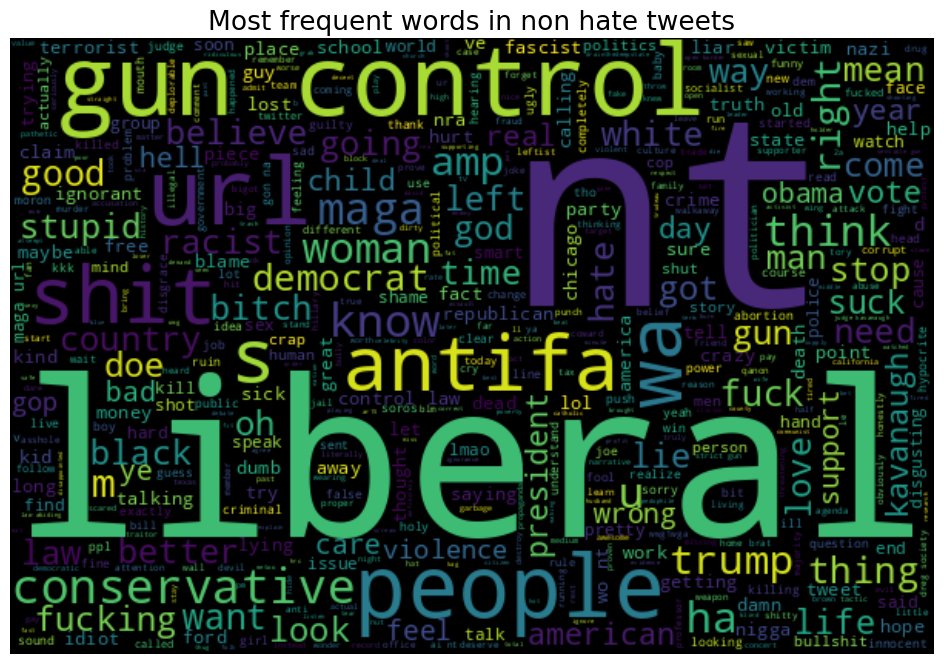

___________________________________________________________
___________________________________________________________
AFTER NOISE REMOVAL :                                                tweet  label
0     trump is declassifying information and ther...      0
1   ha even with them trying to rig the system th...      0
2         man you really thought this was it huh url      0
3   ms clinton  you are a class act my response t...      1
4   its still here at 753 if someone did this to ...      0
___________________________________________________________


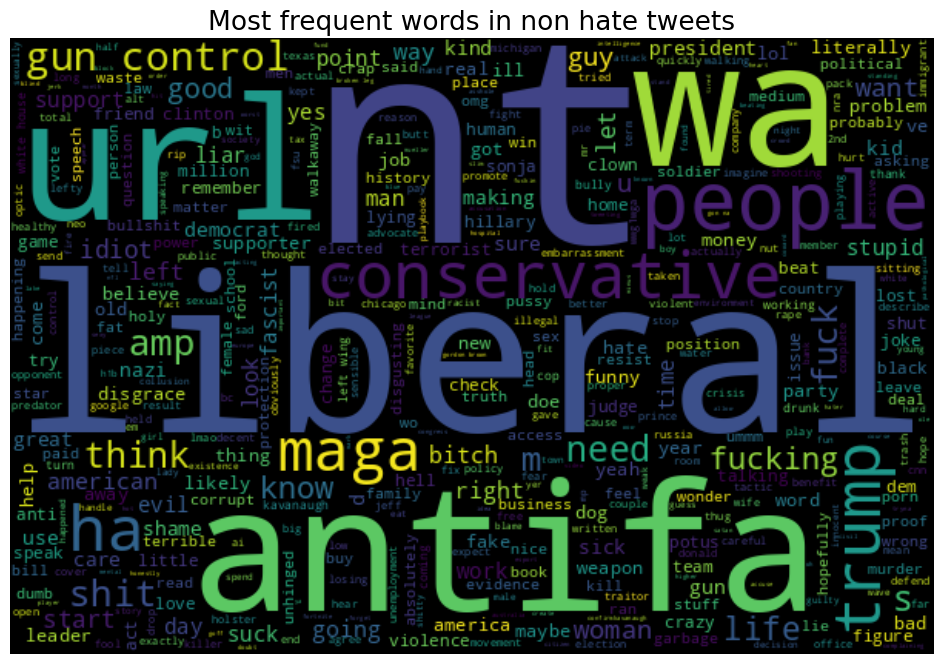

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_4 (Embedding)     (None, 30, 64)            64000     
                                                                 
 conv1d_4 (Conv1D)           (None, 26, 128)           41088     
                                                                 
 global_max_pooling1d_4 (Glo  (None, 128)              0         
 balMaxPooling1D)                                                
                                                                 
 dense_12 (Dense)            (None, 512)               66048     
                                                                 
 dropout_8 (Dropout)         (None, 512)               0         
                                                                 
 dense_13 (Dense)            (None, 8)                 4104      
                                                      

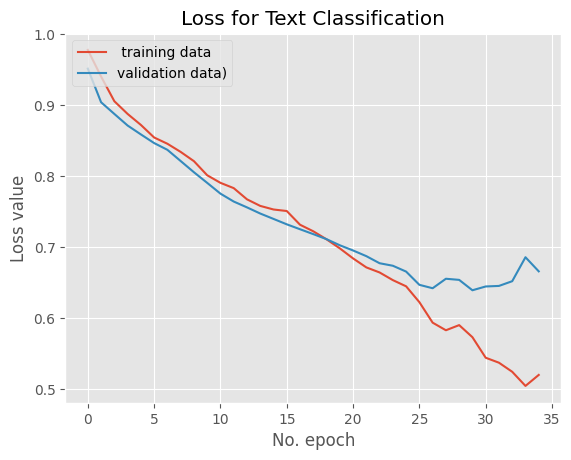

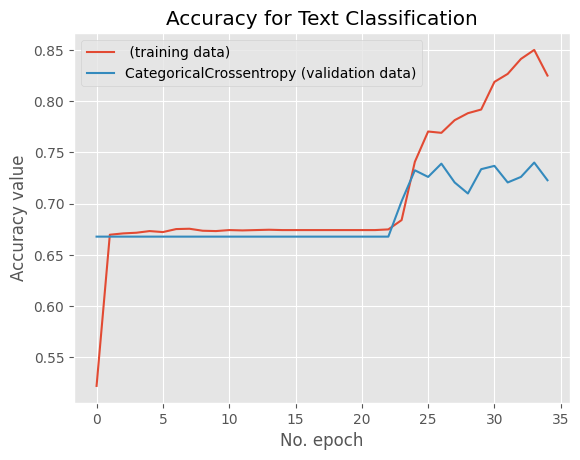

Saved model to  gdrive/MyDrive/./CE807/Assignment2/2201110/models/2/25/model.sav


In [ ]:
train_data = prepare_dataset2(train_25_file)
val_data = prepare_dataset2(val_file)
model_25_file2=train_method2(train_data, val_data, MODEL_2_25_DIRECTORY)


**TRAINING ON 50% OF DATA**

___________________________________________________________
___________________________________________________________
AFTER NOISE REMOVAL :                                                tweet  label
0   that was awesome i love hearing you destroy t...      1
1                         conspiracy theories abound      0
2  #toxictory minister  attempted to expense 50 c...      0
3   lol religion of peace am i right fellow class...      0
4                                  google go to hell      1
___________________________________________________________


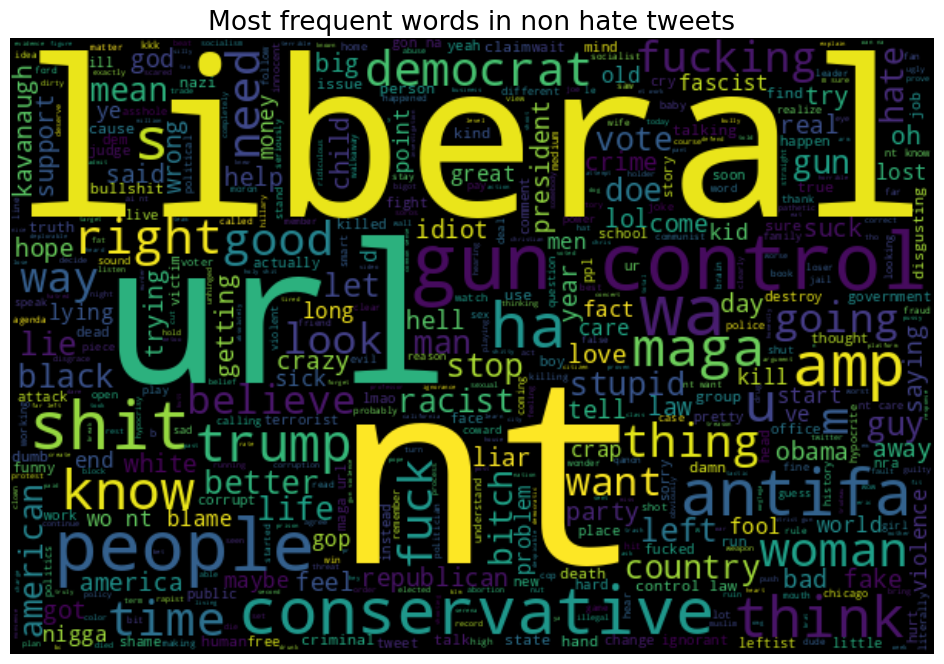

___________________________________________________________
___________________________________________________________
AFTER NOISE REMOVAL :                                                tweet  label
0     trump is declassifying information and ther...      0
1   ha even with them trying to rig the system th...      0
2         man you really thought this was it huh url      0
3   ms clinton  you are a class act my response t...      1
4   its still here at 753 if someone did this to ...      0
___________________________________________________________


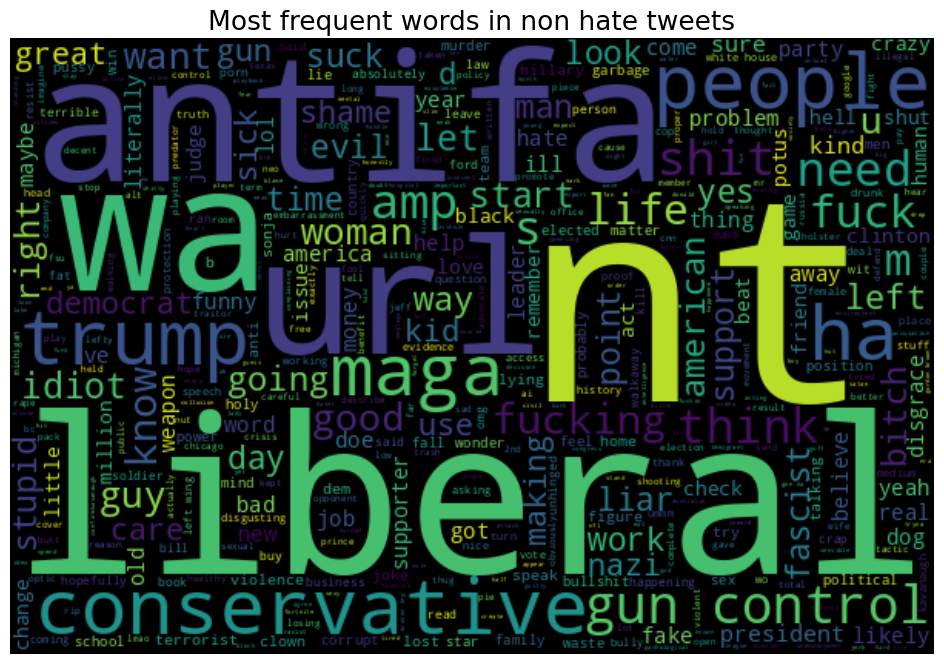

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_5 (Embedding)     (None, 30, 64)            64000     
                                                                 
 conv1d_5 (Conv1D)           (None, 26, 128)           41088     
                                                                 
 global_max_pooling1d_5 (Glo  (None, 128)              0         
 balMaxPooling1D)                                                
                                                                 
 dense_15 (Dense)            (None, 512)               66048     
                                                                 
 dropout_10 (Dropout)        (None, 512)               0         
                                                                 
 dense_16 (Dense)            (None, 8)                 4104      
                                                      

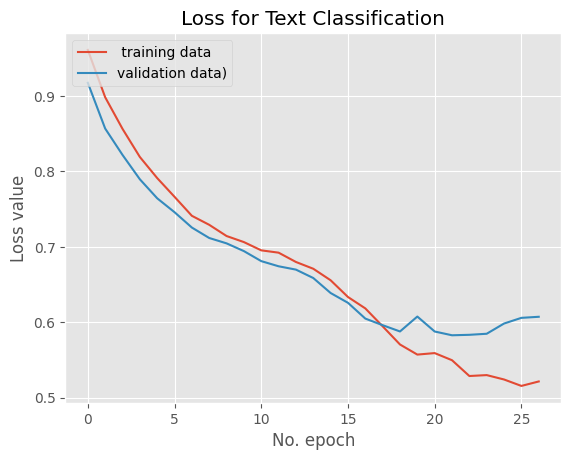

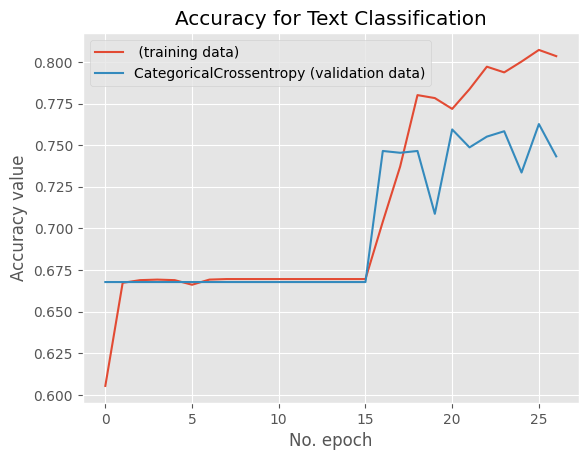

Saved model to  gdrive/MyDrive/./CE807/Assignment2/2201110/models/2/50/model.sav


In [ ]:
train_data = prepare_dataset2(train_50_file)
val_data = prepare_dataset2(val_file)
model_50_file2=train_method2(train_data, val_data, MODEL_2_50_DIRECTORY)

**TRAINING ON 75% OF DATA**

___________________________________________________________
___________________________________________________________
AFTER NOISE REMOVAL :                                                tweet  label
0   that was awesome i love hearing you destroy t...      1
1                         conspiracy theories abound      0
2  #toxictory minister  attempted to expense 50 c...      0
3   lol religion of peace am i right fellow class...      0
4                                  google go to hell      1
___________________________________________________________


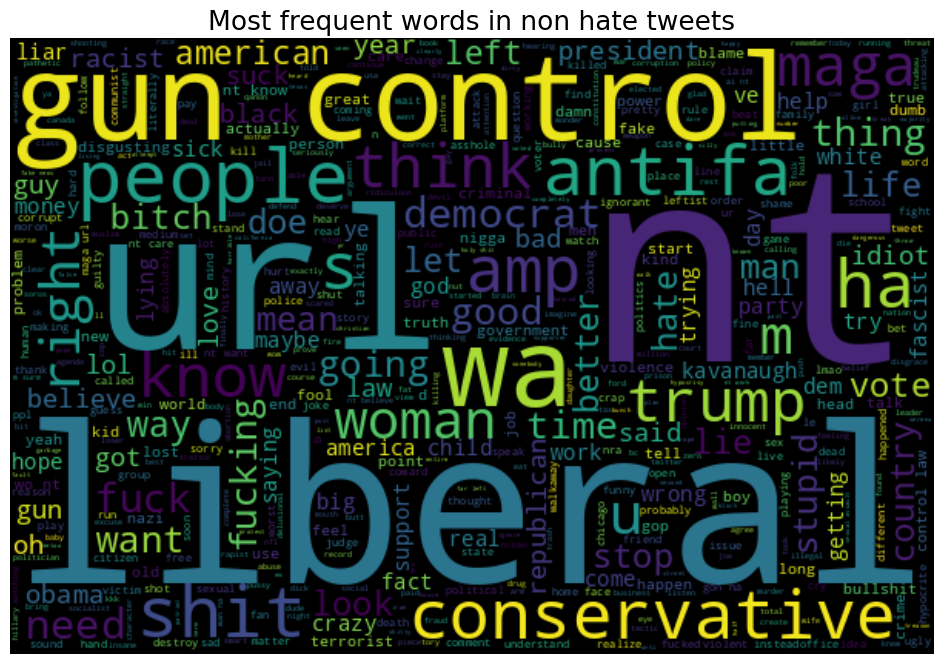

___________________________________________________________
___________________________________________________________
AFTER NOISE REMOVAL :                                                tweet  label
0     trump is declassifying information and ther...      0
1   ha even with them trying to rig the system th...      0
2         man you really thought this was it huh url      0
3   ms clinton  you are a class act my response t...      1
4   its still here at 753 if someone did this to ...      0
___________________________________________________________


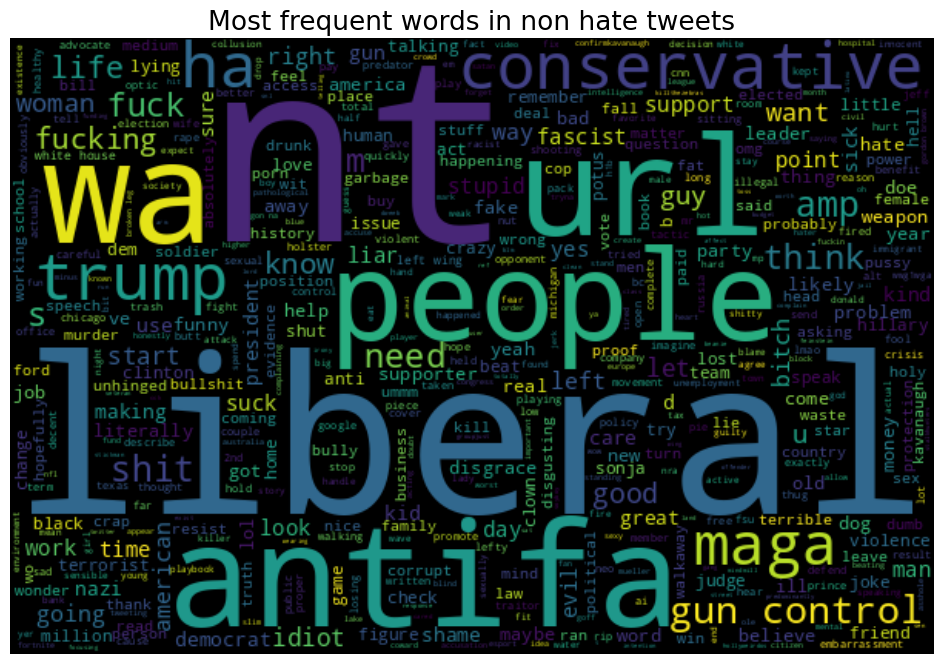

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_6 (Embedding)     (None, 30, 64)            64000     
                                                                 
 conv1d_6 (Conv1D)           (None, 26, 128)           41088     
                                                                 
 global_max_pooling1d_6 (Glo  (None, 128)              0         
 balMaxPooling1D)                                                
                                                                 
 dense_18 (Dense)            (None, 512)               66048     
                                                                 
 dropout_12 (Dropout)        (None, 512)               0         
                                                                 
 dense_19 (Dense)            (None, 8)                 4104      
                                                      

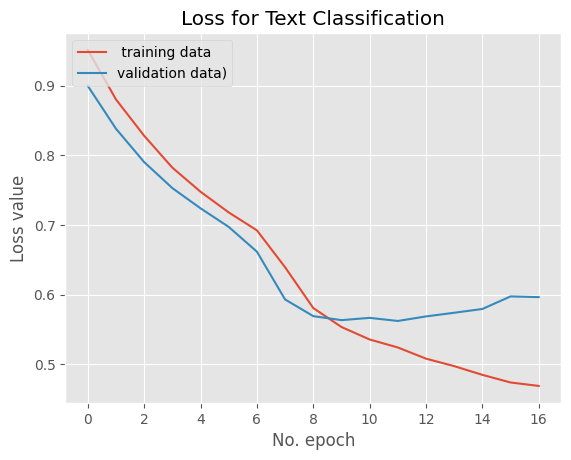

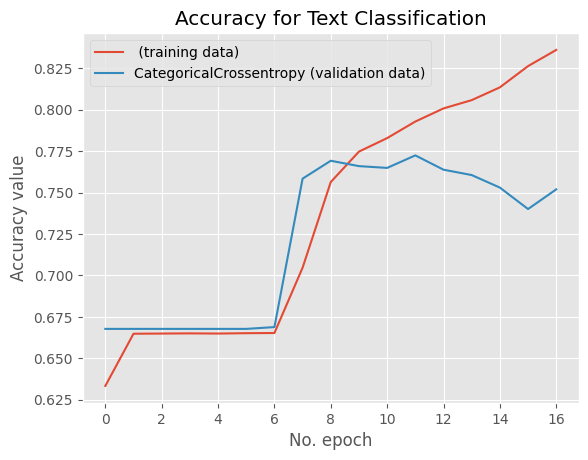

Saved model to  gdrive/MyDrive/./CE807/Assignment2/2201110/models/2/75/model.sav


In [ ]:
train_data = prepare_dataset2(train_75_file)
val_data = prepare_dataset2(val_file)
model_75_file2=train_method2(train_data, val_data, MODEL_2_75_DIRECTORY)

**TRAINING ON 100% OF DATA**

___________________________________________________________
___________________________________________________________
AFTER NOISE REMOVAL :                                                tweet  label
0   that was awesome i love hearing you destroy t...      1
1                         conspiracy theories abound      0
2  #toxictory minister  attempted to expense 50 c...      0
3   lol religion of peace am i right fellow class...      0
4                                  google go to hell      1
___________________________________________________________


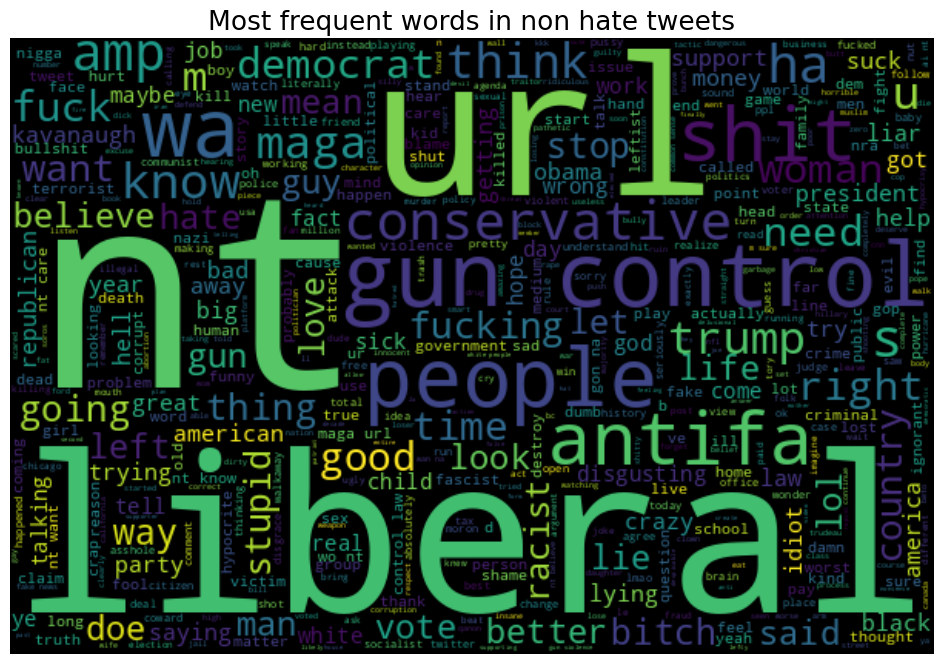

___________________________________________________________
___________________________________________________________
AFTER NOISE REMOVAL :                                                tweet  label
0     trump is declassifying information and ther...      0
1   ha even with them trying to rig the system th...      0
2         man you really thought this was it huh url      0
3   ms clinton  you are a class act my response t...      1
4   its still here at 753 if someone did this to ...      0
___________________________________________________________


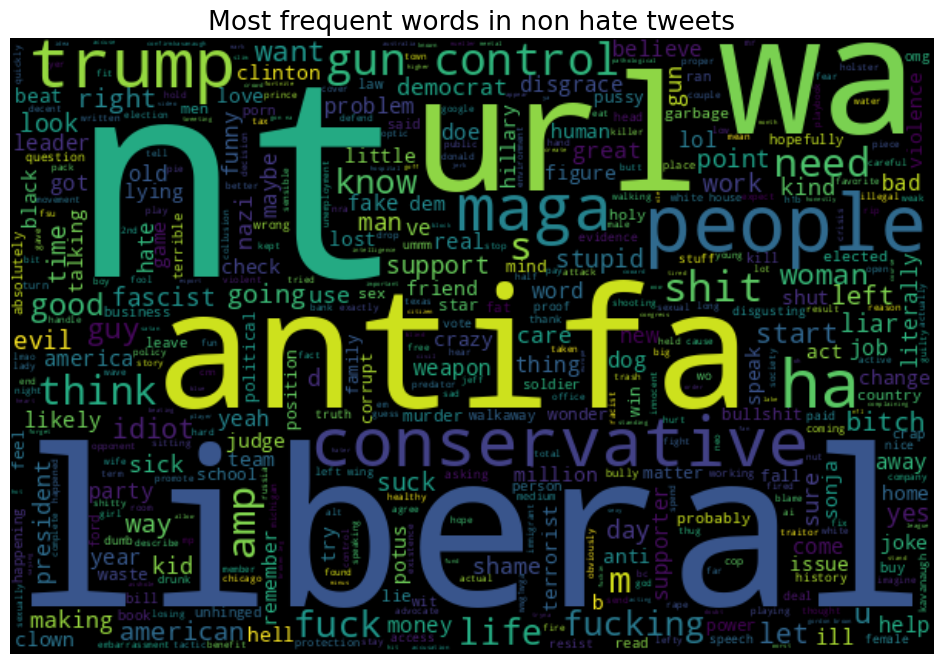

Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_7 (Embedding)     (None, 30, 64)            64000     
                                                                 
 conv1d_7 (Conv1D)           (None, 26, 128)           41088     
                                                                 
 global_max_pooling1d_7 (Glo  (None, 128)              0         
 balMaxPooling1D)                                                
                                                                 
 dense_21 (Dense)            (None, 512)               66048     
                                                                 
 dropout_14 (Dropout)        (None, 512)               0         
                                                                 
 dense_22 (Dense)            (None, 8)                 4104      
                                                      

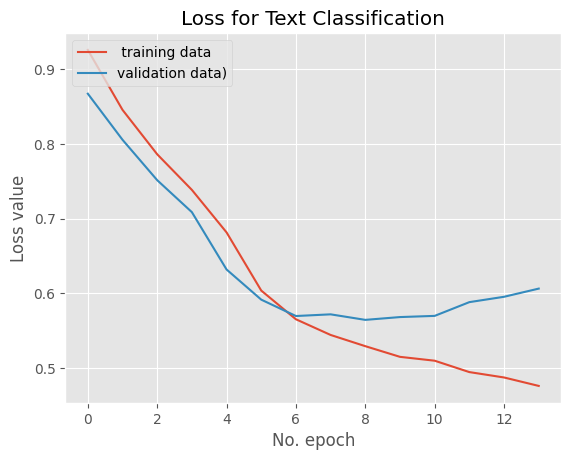

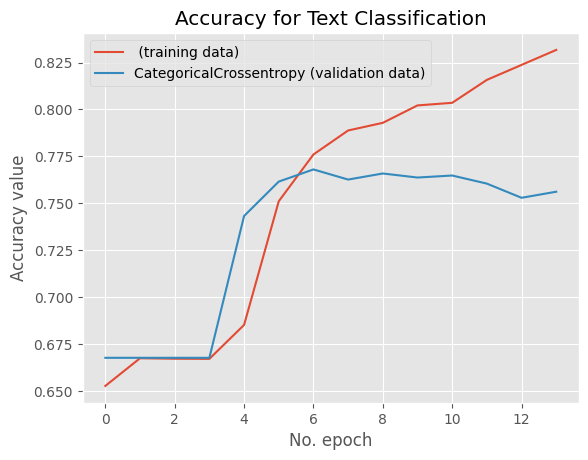

Saved model to  gdrive/MyDrive/./CE807/Assignment2/2201110/models/2/100/model.sav


In [ ]:
train_data = prepare_dataset2(train_file)
val_data = prepare_dataset2(val_file)
model_100_file2=train_method2(train_data, val_data, MODEL_2_100_DIRECTORY)


## Testing Method 2 Code
Your test code should be a stand alone code that must take `test_file`, `model_file` and `output_dir` as input. You could have other things as also input, but these three are must. You would load both files, and generate output based on inputs. Then you will `print` / `display`/ `plot` all performance metrics, and save the output file in the `output_dir`  

In [ ]:
test_data = os.path.join(GOOGLE_DRIVE_PATH, 'test.csv')

In [ ]:
def test_method2(test_file, model_file, output_dir):
  """
     take test_file, model_file and output_dir as input.
     It loads model and test of the examples in the test_file.
     It prints different evaluation metrics, and saves the output in output directory

     ADD Other arguments, if needed

    Args:
        test_file: test file name
        model_file: model file name
        output_dir: Output Directory
    """
    ##########################################################################
    #                     TODO: Implement this function                      #
    ##########################################################################
  test_data = prepare_dataset2(test_file)
  tokenizer = text.Tokenizer(num_words=1000,oov_token="unk")
  tokenizer.fit_on_texts(test_data["tweet"])
  test_x = tokenizer.texts_to_sequences(test_data["tweet"])
  test_x= pad_sequences(test_x, padding='post', maxlen=30)
  # Load model
  import joblib
  model = joblib.load(model_file)
  # Generate predictions
  y_pred = model.predict(test_x)
  #plot predictions
  f, (ax1, ax2) = plt.subplots(1, 2,figsize=(15,5))
  ax1.scatter(y_pred,range(0,len(y_pred)),alpha=0.2)
  y_pred = np.where(y_pred > 0.5, 1, 0)

  output_file = os.path.join(output_dir, 'output_test.csv')
  test_data['output label'] = y_pred
  # Save predictions to file in Google Drive
  if not os.path.exists(output_dir):
      os.makedirs(output_dir)
  output_file = os.path.join(output_dir, 'output_test.csv')
  test_data.to_csv(output_file, columns=['tweet', 'label', 'output label'], index=False)

  # Compute performance metrics
  y_test = test_data['label']
  compute_performance2(y_test, y_pred)

    ##########################################################################
    #                            END OF YOUR CODE                            #
    ##########################################################################


___________________________________________________________
___________________________________________________________
AFTER NOISE REMOVAL :                                                tweet  label
0  #whoisq #wherestheserver #dumpnike #declasfisa...      1
1  #constitutionday is revered by conservatives h...      0
2  #foxnews #nra #maga #potus #trump #2ndamendmen...      0
3  #watching #boomer getting the news that she is...      0
4  #nopasaran unity demo to oppose the farright i...      1
___________________________________________________________


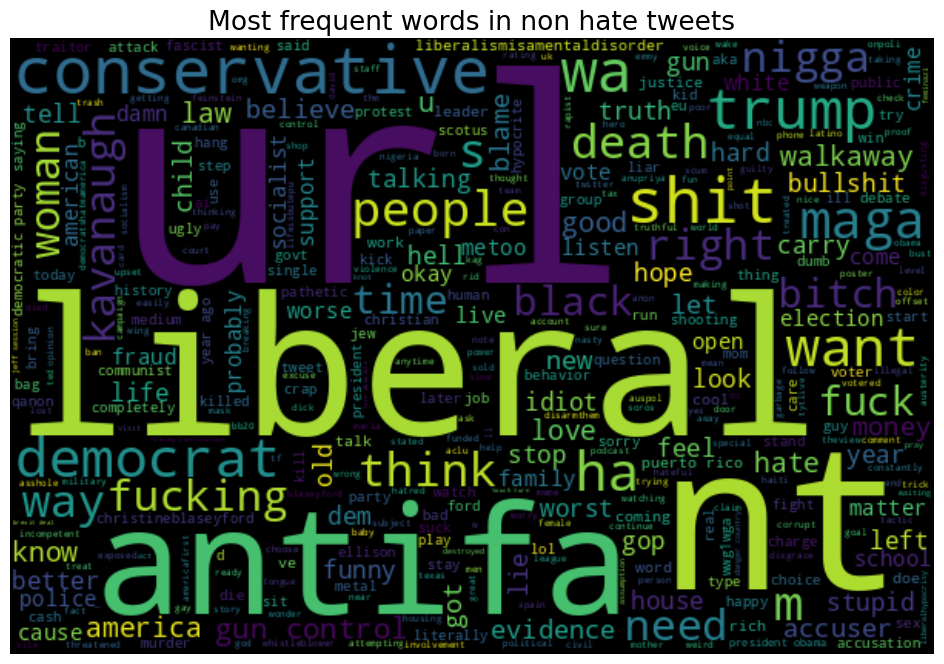

27/27 [==============================] - 0s 4ms/step
head
Accuracy: 0.58
F1 score: 0.49
[[431 181]
 [173  64]]
              precision    recall  f1-score   support

           0       0.71      0.70      0.71       612
           1       0.26      0.27      0.27       237

    accuracy                           0.58       849
   macro avg       0.49      0.49      0.49       849
weighted avg       0.59      0.58      0.59       849



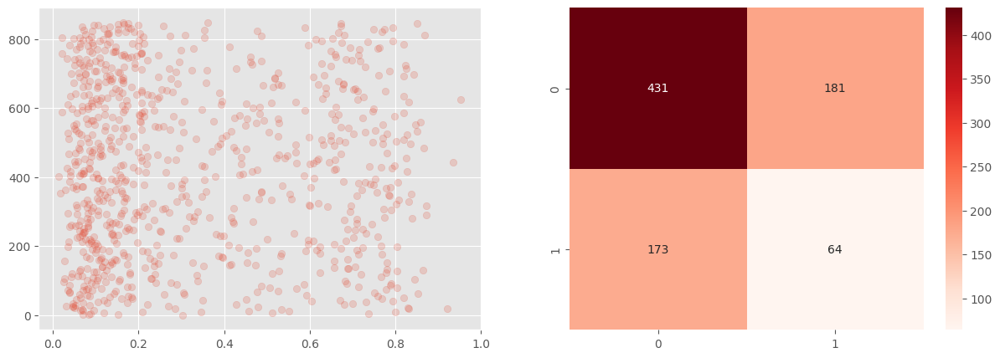

In [ ]:
test_method2(test_file, model_25_file2, MODEL_2_25_DIRECTORY)

___________________________________________________________
___________________________________________________________
AFTER NOISE REMOVAL :                                                tweet  label
0  #whoisq #wherestheserver #dumpnike #declasfisa...      1
1  #constitutionday is revered by conservatives h...      0
2  #foxnews #nra #maga #potus #trump #2ndamendmen...      0
3  #watching #boomer getting the news that she is...      0
4  #nopasaran unity demo to oppose the farright i...      1
___________________________________________________________


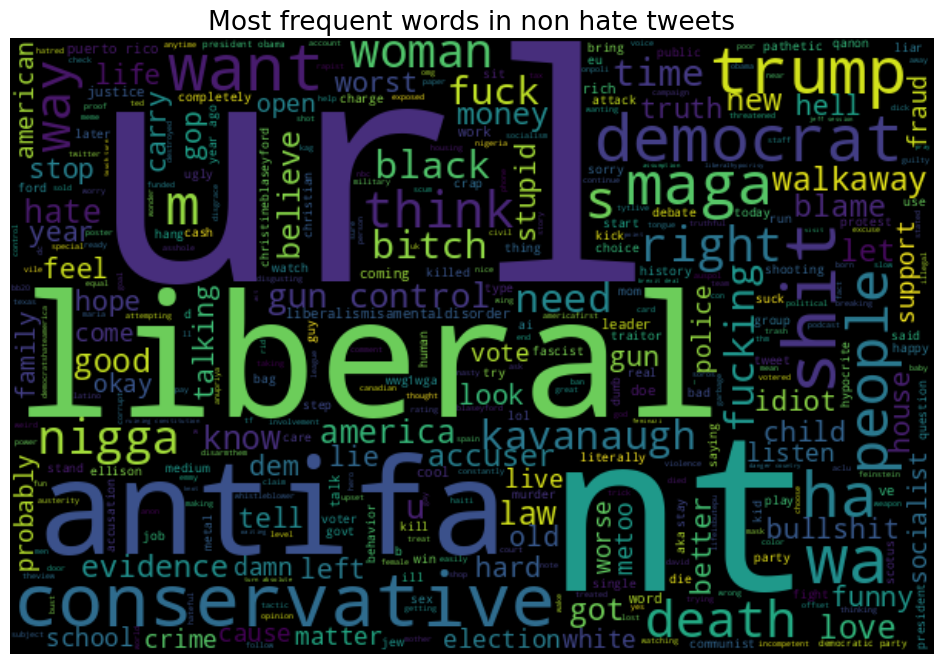

27/27 [==============================] - 0s 4ms/step
head
Accuracy: 0.61
F1 score: 0.53
[[437 175]
 [153  84]]
              precision    recall  f1-score   support

           0       0.74      0.71      0.73       612
           1       0.32      0.35      0.34       237

    accuracy                           0.61       849
   macro avg       0.53      0.53      0.53       849
weighted avg       0.62      0.61      0.62       849



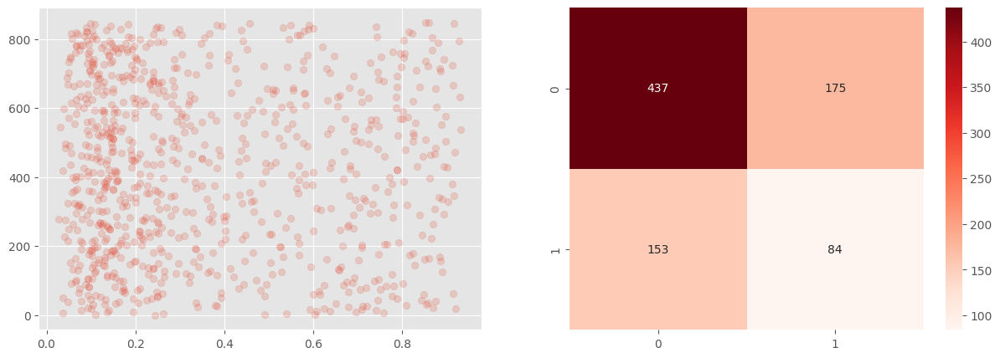

In [ ]:
test_method2(test_file, model_50_file2, MODEL_2_50_DIRECTORY)

___________________________________________________________
___________________________________________________________
AFTER NOISE REMOVAL :                                                tweet  label
0  #whoisq #wherestheserver #dumpnike #declasfisa...      1
1  #constitutionday is revered by conservatives h...      0
2  #foxnews #nra #maga #potus #trump #2ndamendmen...      0
3  #watching #boomer getting the news that she is...      0
4  #nopasaran unity demo to oppose the farright i...      1
___________________________________________________________


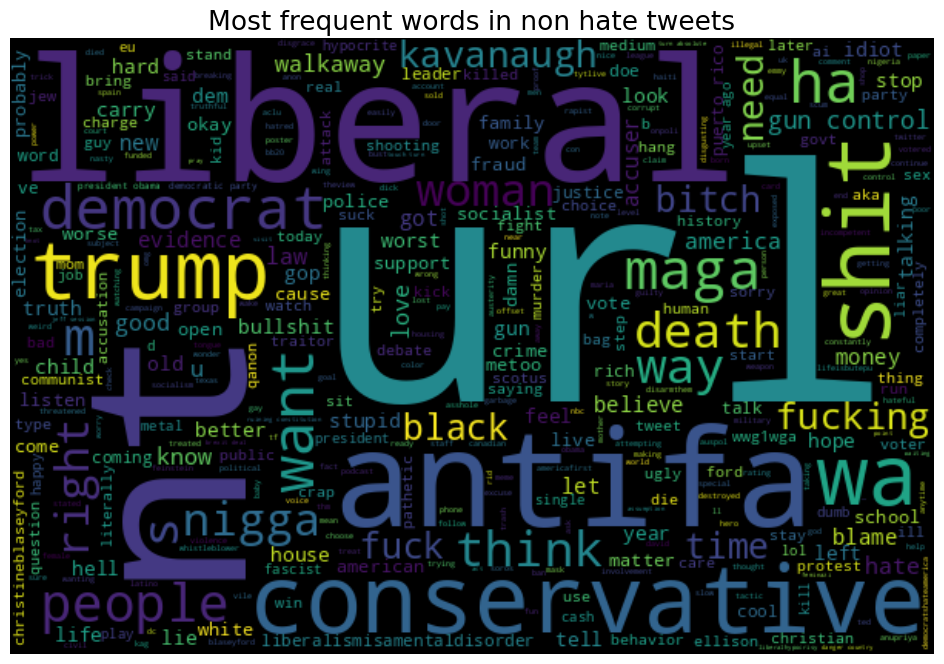

27/27 [==============================] - 0s 4ms/step
head
Accuracy: 0.61
F1 score: 0.49
[[462 150]
 [184  53]]
              precision    recall  f1-score   support

           0       0.72      0.75      0.73       612
           1       0.26      0.22      0.24       237

    accuracy                           0.61       849
   macro avg       0.49      0.49      0.49       849
weighted avg       0.59      0.61      0.60       849



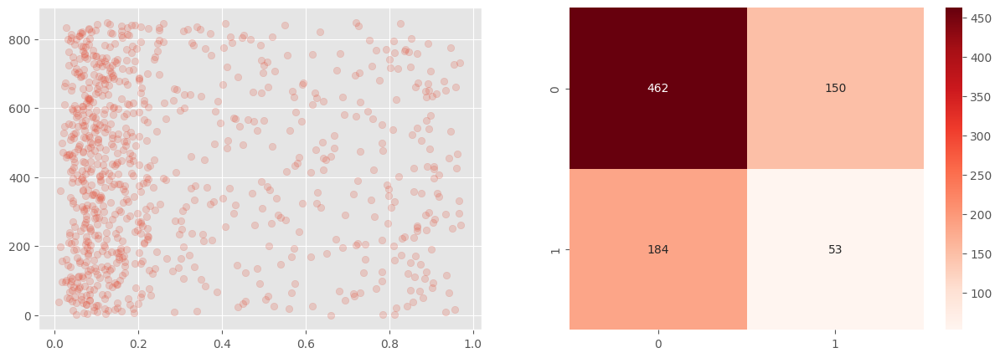

In [ ]:
test_method2(test_file, model_75_file2, MODEL_2_75_DIRECTORY)

___________________________________________________________
___________________________________________________________
AFTER NOISE REMOVAL :                                                tweet  label
0  #whoisq #wherestheserver #dumpnike #declasfisa...      1
1  #constitutionday is revered by conservatives h...      0
2  #foxnews #nra #maga #potus #trump #2ndamendmen...      0
3  #watching #boomer getting the news that she is...      0
4  #nopasaran unity demo to oppose the farright i...      1
___________________________________________________________


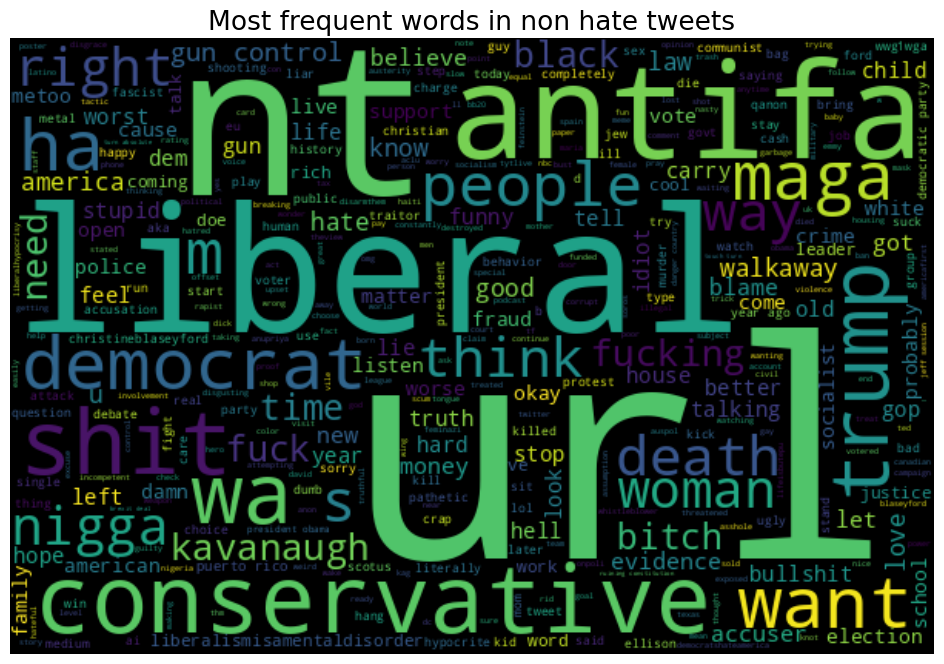

27/27 [==============================] - 0s 4ms/step
head
Accuracy: 0.58
F1 score: 0.48
[[435 177]
 [177  60]]
              precision    recall  f1-score   support

           0       0.71      0.71      0.71       612
           1       0.25      0.25      0.25       237

    accuracy                           0.58       849
   macro avg       0.48      0.48      0.48       849
weighted avg       0.58      0.58      0.58       849



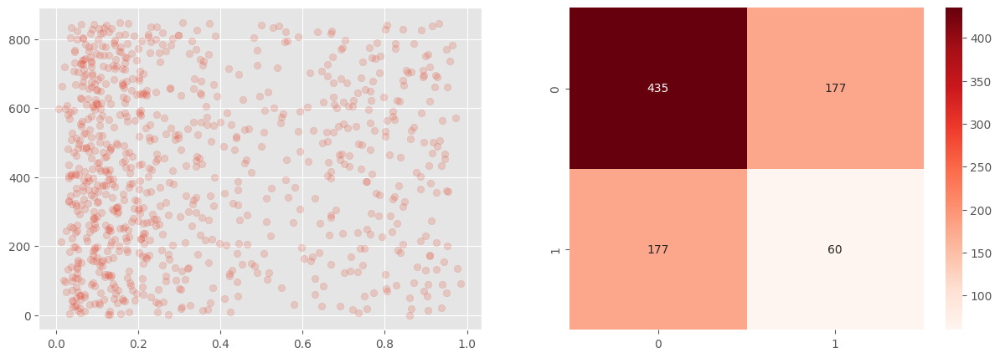

In [ ]:
test_method2(test_file, model_100_file2, MODEL_2_100_DIRECTORY)

## Method 2 End


# Other Method/model Start

In [ ]:
def save_model2(model,model_dir):
    # save the model to disk
    model_file = os.path.join(model_dir, 'model.sav')
    pickle.dump(model, open(model_file, 'wb'))

    print('Saved model to ', model_file)
    return model_file

In [ ]:
def compute_performance2(y_true, y_pred,split='test'):
  """
    prints different performance matrics like  Accuracy, Recall (macro), Precision (macro), and F1 (macro).
    This also display Confusion Matrix with proper X & Y axis labels.
    Also, returns F1 score
    Args:
        y_true: numpy array or list
        y_pred: numpy array or list
    Returns:
        float
    """
    ##########################################################################
    #                     TODO: Implement this function                      #
    ##########################################################################
  print("head")
  acc = accuracy_score(y_true, y_pred)
  # Calculate F1 score
  f1score=f1_score(y_true, y_pred, average='macro')
  print("Accuracy: {:.2f}".format(acc))
  print("F1 score: {:.2f}".format(f1score))
  valid_accuracy_list2.append(acc*100)
  #Calculate confusion matrix
  cm = confusion_matrix(y_true, y_pred)
  print(cm)

  from sklearn.metrics import classification_report
  print(classification_report(y_true, y_pred))
  # Plot confusion matrix using heatmap
  sns.heatmap(cm, annot=True, fmt='d', cmap='Reds')
  plt.show()

    ##########################################################################
    #                            END OF YOUR CODE                            #
    ##########################################################################


##Other Method/model End

In [ ]:
# read the CSV files into pandas dataframes
model_2_100_output_df = pd.read_csv('gdrive/MyDrive/./CE807/Assignment2/2201110/models/1/100/output_test.csv')
model_2_75_output_df = pd.read_csv('gdrive/MyDrive/./CE807/Assignment2/2201110/models/1/75/output_test.csv')
model_2_50_output_df = pd.read_csv('gdrive/MyDrive/./CE807/Assignment2/2201110/models/1/50/output_test.csv')
model_2_25_output_df = pd.read_csv('gdrive/MyDrive/./CE807/Assignment2/2201110/models/1/25/output_test.csv')


# define the rows you want to select
rows = [772, 255, 30, 80, 460]

# create a new dataframe to hold the selected rows and predictions
df = pd.DataFrame(columns=['tweet', 'label', '100%', '75%', '50%', '25%'])

# populate dataframe with selected rows and predictions from both models
for row in rows:
    tweet = model_2_100_output_df.iloc[row]['tweet']
    label = model_2_100_output_df.iloc[row]['label']
    model_2_100 = model_2_100_output_df.iloc[row]['out_label']
    model_2_75 = model_2_75_output_df.iloc[row]['out_label']
    model_2_50 = model_2_50_output_df.iloc[row]['out_label']
    model_2_25 = model_2_25_output_df.iloc[row]['out_label']
    #print(tweet,label, model_2_100, model_2_75, model_2_50,model_2_25)
    df.loc[len(df)] = [tweet,label, model_2_100, model_2_75,model_2_50,model_2_25]

df

,tweet,label,100%,75%,50%,25%
0,#Season2 #scary Er while we are on the subject...,NOT,NOT,NOT,NOT,NOT
1,#Emmys sooo lovely I love the dress colour and...,NOT,NOT,NOT,NOT,NOT
2,#ChristineBlaseyFord is your #Kavanaugh accuse...,OFF,NOT,NOT,NOT,NOT
3,@USER Antifa has TS level influence. It's scary.,OFF,NOT,NOT,NOT,NOT
4,#Feinstein you cant say anything truthful. Yo...,OFF,NOT,NOT,NOT,NOT


In [ ]:
# read the CSV files into pandas dataframes
model_2_100_output_df2 = pd.read_csv('gdrive/MyDrive/./CE807/Assignment2/2201110/models/2/100/output_test.csv')
model_2_75_output_df2 = pd.read_csv('gdrive/MyDrive/./CE807/Assignment2/2201110/models/2/75/output_test.csv')
model_2_50_output_df2 = pd.read_csv('gdrive/MyDrive/./CE807/Assignment2/2201110/models/2/50/output_test.csv')
model_2_25_output_df2 = pd.read_csv('gdrive/MyDrive/./CE807/Assignment2/2201110/models/2/25/output_test.csv')


# define the rows you want to select
rows = [772, 255, 30, 80, 457]

# create a new dataframe to hold the selected rows and predictions
df = pd.DataFrame(columns=['tweet', 'label', '100%', '75%', '50%', '25%'])

# populate dataframe with selected rows and predictions from both models
for row in rows:
    tweet = model_2_100_output_df2.iloc[row]['tweet']
    label = model_2_100_output_df2.iloc[row]['label']
    model_2_100 = model_2_100_output_df2.iloc[row]['output label']
    model_2_75 = model_2_75_output_df2.iloc[row]['output label']
    model_2_50 = model_2_50_output_df2.iloc[row]['output label']
    model_2_25 = model_2_25_output_df2.iloc[row]['output label']
    #print(tweet,label, model_2_100, model_2_75, model_2_50,model_2_25)
    df.loc[len(df)] = [tweet,label, model_2_100, model_2_75,model_2_50,model_2_25]

df

,tweet,label,100%,75%,50%,25%
0,# crazyredhead # angry # orange # cheeto claim...,1,1,0,0,0
1,bitch m fucking coming url,1,0,0,1,0
2,# christineblaseyford # kavanaugh accuser # li...,1,0,0,1,0
3,account quasianonymous completely anon twitter...,1,0,1,1,1
4,# celebration # germany # german yeah kind exp...,0,1,1,0,0
